# Projeto Patinagem

Em primeiro lugar guardamos todos os frames numa lista para termos mais facilmente acesso a cada frame individuais

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from time import time
from cv2 import VideoCapture

def load_frames(videoPath):
    cap = VideoCapture(videoPath)
    start = time()

    
    frameArray = []
    print("Collecting frame data")
    while 1:
        ret, frame = cap.read()
        if frame is None:
            print("Frame Data Collected")
            break

        target = frame[60:630, 380:1100]
        frameArray.append(target)
        
        if cv2.waitKey(1) == 27 or cv2.waitKey(1) == 113 or cv2.waitKey(1) == 81:
            cap.release()
            exit(0)
            break


    
    end = time()
    print("Time spent collecting : " + str(end-start))
    print("Amount of frames collected : "+ str(len(frameArray)))
    return frameArray

        
frameArray = load_frames('./VideoContent/sampleVid.webm')      
        

Frame Data Collected
Time spent collecting : 41.54290461540222
Amount of frames collected : 2827


Foram obtidos alguns frames de "Corner Cases" que achamos apropiados e, de seguida, procedemos a obter os histogramas 

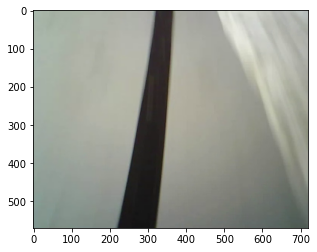

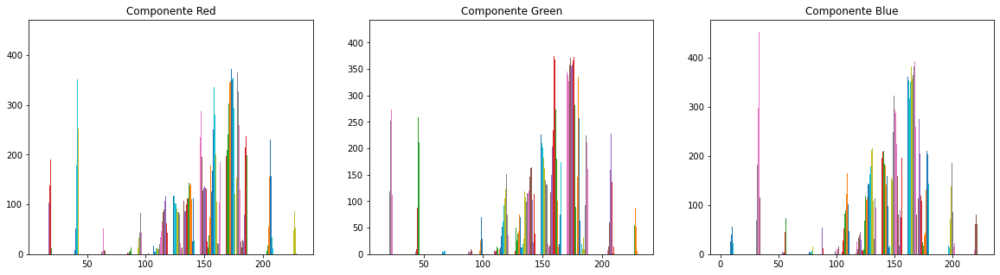

-------------------------------------------------HSV--------------------------------------------


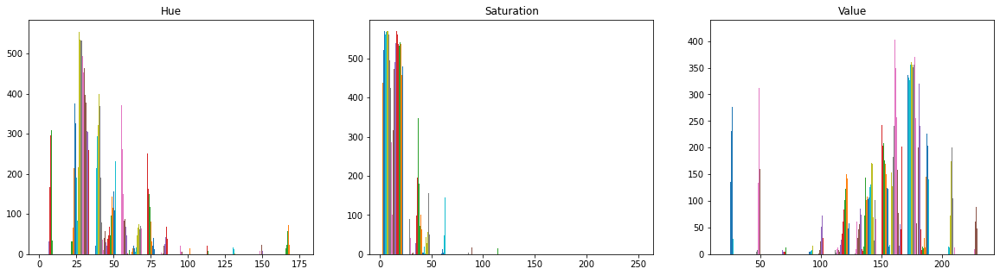

-----------------------------------------------YCBCR--------------------------------------------


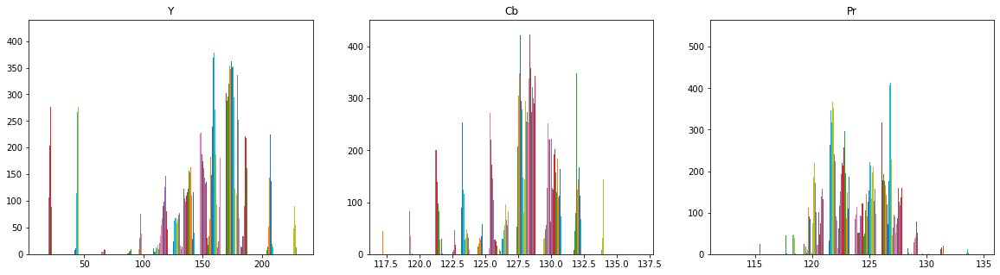

In [2]:
#Slideshow to obtain relevant frames
"""
frameAct = 0
for i in frameArray:
    print(frameAct)
    cv2.imshow('Video',i)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
    frameAct += 1
    """

relevantFrames = [142,143,146,367,379,387,393,399,444,480,486,822,876]
"""
for i in relevantFrames:
    imgplot = plt.imshow(cv2.cvtColor(frameArray[i],cv2.COLOR_BGR2RGB))
    plt.show()
"""
    
relevantFrames = [367]


for i in relevantFrames:
    #print(i)

    imgplot = plt.imshow(cv2.cvtColor(frameArray[i],cv2.COLOR_BGR2RGB))
    plt.show()
    b = frameArray[i][:,:,0]
    g = frameArray[i][:,:,1]
    r = frameArray[i][:,:,2]
    #Histogram
    #Red component
    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Componente Red")
    plt.hist(r)
    fig.add_subplot(1,3,2)
    plt.title("Componente Green")
    plt.hist(g)
    fig.add_subplot(1,3,3)
    plt.title("Componente Blue")
    plt.hist(b)
    plt.show()
    
    print("-------------------------------------------------HSV--------------------------------------------")
    
    hsv = cv2.cvtColor(frameArray[i], cv2.COLOR_BGR2HSV)
    h,s,v = cv2.split(hsv)
    """
    norm_s = [(value*100/255)*100 for value in s]
    norm_v = [(value*100/255)*100 for value in v]
    """
    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Hue")
    plt.hist(h)
    fig.add_subplot(1,3,2)
    plt.title("Saturation")
    plt.hist(s)
    fig.add_subplot(1,3,3)
    plt.title("Value")
    plt.hist(v)
    plt.show()
    
    print("-----------------------------------------------YCBCR--------------------------------------------")
    
    ycbcr = cv2.cvtColor(frameArray[i], cv2.COLOR_BGR2YCR_CB)
    
    y,pb,pr = cv2.split(ycbcr)
    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Y")
    plt.hist(y)
    fig.add_subplot(1,3,2)
    plt.title("Cb")
    plt.hist(pb)
    fig.add_subplot(1,3,3)
    plt.title("Pr")
    plt.hist(pr)
    plt.show()
    



Obtivemos os histogramas para 3 espaços de cor diferentes: RBG, HSV e YCBCR.
De seguida, iremos observar novamente os histogramas, mas desta vez restringindo apenas a certas zonas, como por exemplo, uma linha, sendo que ao observar a imagem completa, temos uma dispersão maior das cores ao longo do histograma, o que tornará complicada a decisão do que é, de facto, linha ou chão.


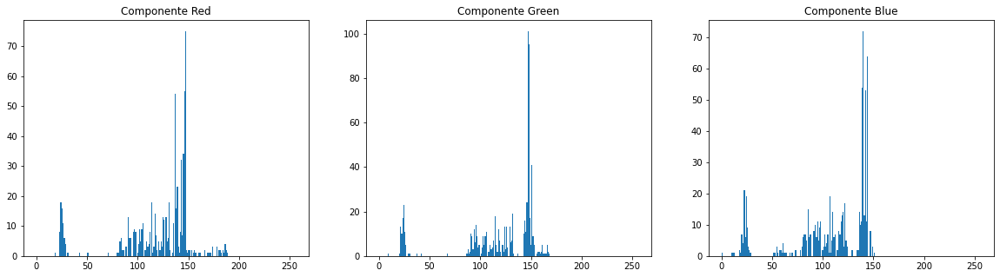

-------------------------------------------------HSV--------------------------------------------


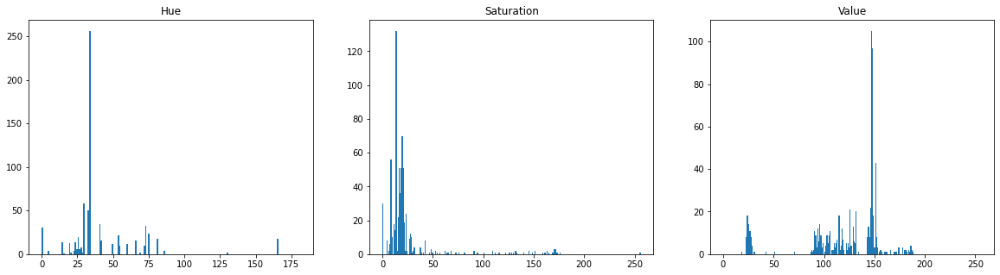

-----------------------------------------------YCBCR--------------------------------------------


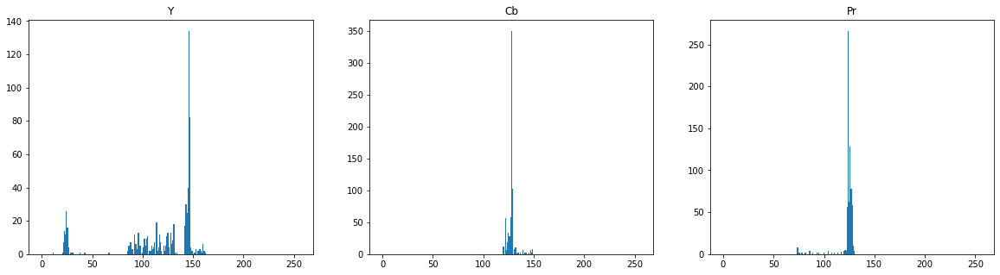

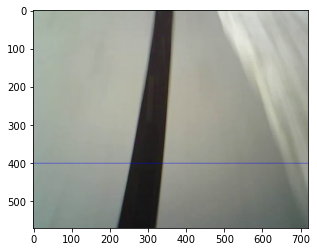

In [3]:
for i in relevantFrames:
    #print(i)


    b = frameArray[387][400,:,0]
    g = frameArray[387][400,:,1]
    r = frameArray[387][400,:,2]

    #Histogram
    #Red component
    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Componente Red")
    plt.hist(r,range = (0,256) , bins =255)
    fig.add_subplot(1,3,2)
    plt.title("Componente Green")
    plt.hist(g,range = (0,256) , bins =255)
    fig.add_subplot(1,3,3)
    plt.title("Componente Blue")
    plt.hist(b,range = (0,256) , bins =255)
    plt.show()

    print("-------------------------------------------------HSV--------------------------------------------")
    
    hsv = cv2.cvtColor(frameArray[387], cv2.COLOR_BGR2HSV)
    h,s,v = cv2.split(hsv)
    """
    norm_h = [(value/180)*360 for value in h]
    norm_s = [(value/100)*255 for value in s]
    norm_v = [(value/100)*255 for value in v]
    """
    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Hue")
    plt.hist(h[400,:],range = (0,181) , bins =180)
    fig.add_subplot(1,3,2)
    plt.title("Saturation")
    plt.hist(s[400],range = (0,256) , bins =255)
    fig.add_subplot(1,3,3)
    plt.title("Value")
    plt.hist(v[400],range = (0,256) , bins =255)
    plt.show()
    
    print("-----------------------------------------------YCBCR--------------------------------------------")
    ycbcr = cv2.cvtColor(frameArray[387], cv2.COLOR_BGR2YCR_CB)
    
    y,pb,pr = cv2.split(ycbcr)
    
    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Y")
    plt.hist(y[400,:],range = (0,256) , bins =255)
    fig.add_subplot(1,3,2)
    plt.title("Cb")
    plt.hist(pb[400,:],range = (0,256) , bins =255)
    fig.add_subplot(1,3,3)
    plt.title("Pr")
    plt.hist(pr[400,:],range = (0,256) , bins =255)
    plt.show()
    
    imageLine = frameArray[i].copy()
    cv2.line(imageLine,(0,400),(720,400),(255,0,0),1)
    imgplot = plt.imshow(cv2.cvtColor(imageLine,cv2.COLOR_BGR2RGB))
    plt.show()
    

Aqui, como podemos observar, já temos os valores mais concentrados em zonas mais concretas, e, por exemplo, no espaço RBG podemos observar que existe uma maior concentração por volta dos 50 e 125 nas abcissas e depois mais perto do valor 150, o que nos indica que existe uma separação clara nas concentrações das cores, representando duas zonas diferentes nos frames (a linha e o chão, por exemplo).

Pixeis Chão


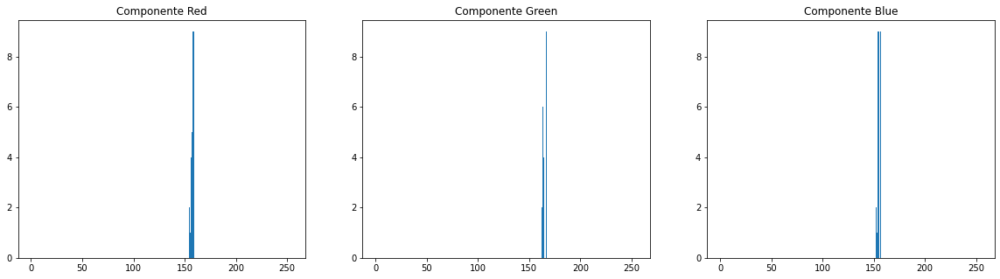

-------------------------------------------------HSV--------------------------------------------


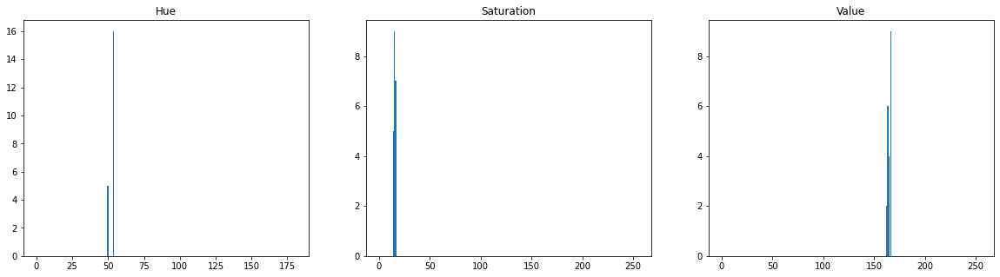

-----------------------------------------------YCBCR--------------------------------------------


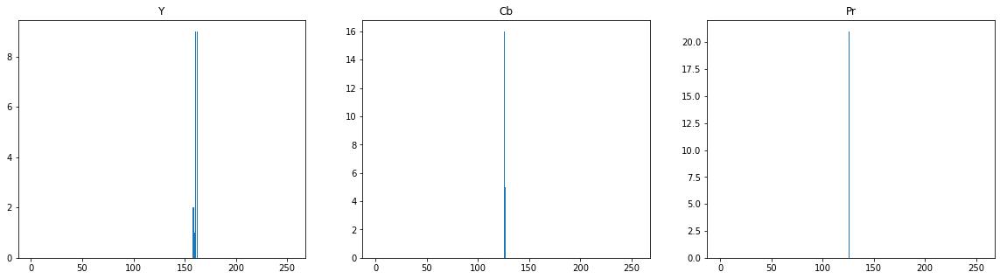

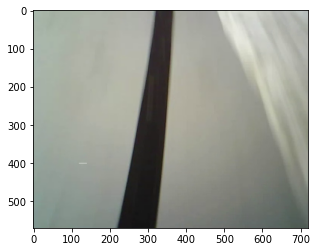

In [4]:
    
print("Pixeis Chão")  
for i in relevantFrames:
    #print(i)


    b = frameArray[i][400,120:141,0]
    g = frameArray[i][400,120:141,1]
    r = frameArray[i][400,120:141,2]

    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Componente Red")
    plt.hist(r,range = (0,255) , bins =255)
    fig.add_subplot(1,3,2)
    plt.title("Componente Green")
    plt.hist(g,range = (0,255) , bins =255)
    fig.add_subplot(1,3,3)
    plt.title("Componente Blue")
    plt.hist(b,range = (0,255) , bins =255)
    plt.show()
    
    print("-------------------------------------------------HSV--------------------------------------------")

    hsv = cv2.cvtColor(frameArray[i], cv2.COLOR_BGR2HSV)
    h,s,v = cv2.split(hsv)
    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Hue")
    plt.hist(h[400,120:141],range = (0,181) , bins =180)
    fig.add_subplot(1,3,2)
    plt.title("Saturation")
    plt.hist(s[400,120:141],range = (0,255) , bins =255)
    fig.add_subplot(1,3,3)
    plt.title("Value")
    plt.hist(v[400,120:141],range = (0,255) , bins =255)
    plt.show()
    
    print("-----------------------------------------------YCBCR--------------------------------------------")
    ycbcr = cv2.cvtColor(frameArray[i], cv2.COLOR_BGR2YCR_CB)
    
    y,pb,pr = cv2.split(ycbcr)
    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Y")
    plt.hist(y[400,120:141],range = (0,255) , bins =255)
    fig.add_subplot(1,3,2)
    plt.title("Cb")
    plt.hist(pb[400,120:141],range = (0,255) , bins =255)
    fig.add_subplot(1,3,3)
    plt.title("Pr")
    plt.hist(pr[400,120:141],range = (0,255) , bins =255)
    plt.show()
    
    imageDots = frameArray[i].copy()
    imageDots[400,120:141] = (255,255,255)
    
    imgplot = plt.imshow(cv2.cvtColor(imageDots,cv2.COLOR_BGR2RGB))
    plt.show()
    


Pixeis Linha


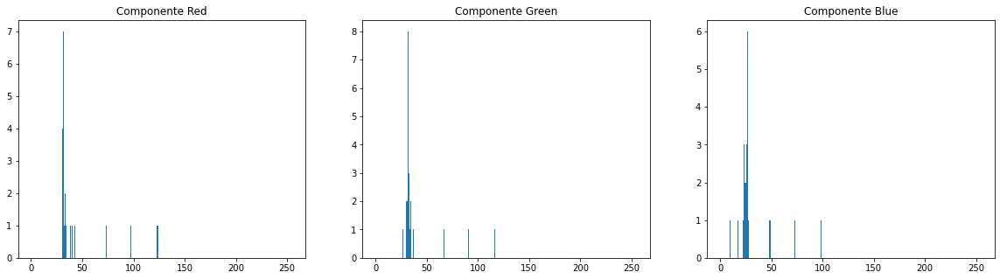

-------------------------------------------------HSV--------------------------------------------


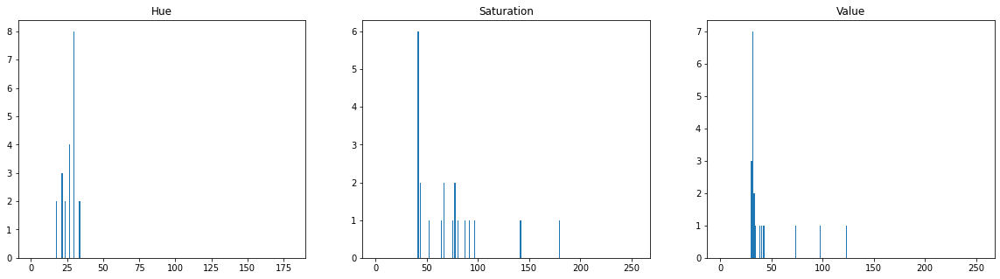

-----------------------------------------------YCBCR--------------------------------------------


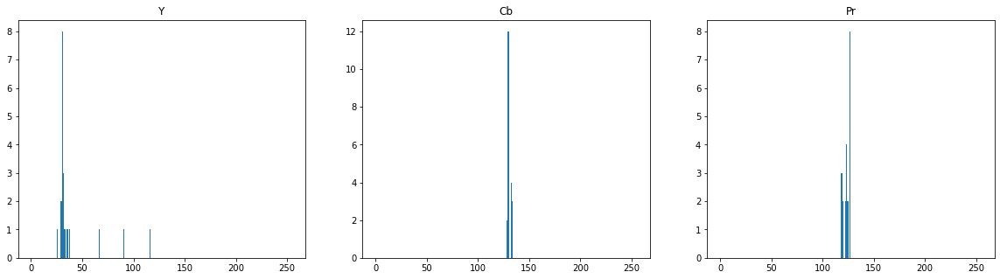

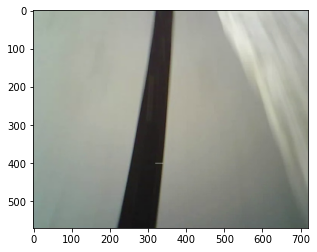

In [5]:
print("Pixeis Linha")  

for i in relevantFrames:
    #print(i)


    b = frameArray[i][400,320:341,0]
    g = frameArray[i][400,320:341,1]
    r = frameArray[i][400,320:341,2]

    #Histogram
    #Red component
    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Componente Red")
    plt.hist(r,range = (0,255) , bins =255)
    fig.add_subplot(1,3,2)
    plt.title("Componente Green")
    plt.hist(g,range = (0,255) , bins =255)
    fig.add_subplot(1,3,3)
    plt.title("Componente Blue")
    plt.hist(b,range = (0,255) , bins =255)
    plt.show()
    
    print("-------------------------------------------------HSV--------------------------------------------")

    hsv = cv2.cvtColor(frameArray[i], cv2.COLOR_BGR2HSV)
    h,s,v = cv2.split(hsv)
    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Hue")
    plt.hist(h[400,320:341],range = (0,181) , bins =180)
    fig.add_subplot(1,3,2)
    plt.title("Saturation")
    plt.hist(s[400,320:341],range = (0,255) , bins =255)
    fig.add_subplot(1,3,3)
    plt.title("Value")
    plt.hist(v[400,320:341],range = (0,255) , bins =255)
    plt.show()
    
    print("-----------------------------------------------YCBCR--------------------------------------------")
    ycbcr = cv2.cvtColor(frameArray[i], cv2.COLOR_BGR2YCR_CB)
    
    y,pb,pr = cv2.split(ycbcr)
    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,3,1)
    plt.title("Y")
    plt.hist(y[400,320:341],range = (0,255) , bins =255)
    fig.add_subplot(1,3,2)
    plt.title("Cb")
    plt.hist(pb[400,320:341],range = (0,255) , bins =255)
    fig.add_subplot(1,3,3)
    plt.title("Pr")
    plt.hist(pr[400,320:341],range = (0,255) , bins =255)
    plt.show()
    
    imageDots = frameArray[i].copy()
    imageDots[400,320:341] = (255,255,255)
    imgplot = plt.imshow(cv2.cvtColor(imageDots,cv2.COLOR_BGR2RGB))
    plt.show()

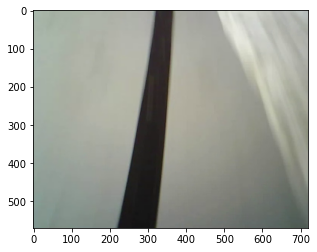

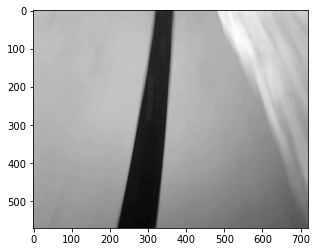

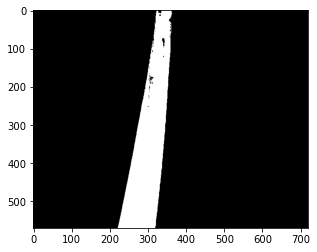

In [6]:
for i in relevantFrames:


    imgplot = plt.imshow(cv2.cvtColor(frameArray[367],cv2.COLOR_BGR2RGB))
    plt.show()
    gray = cv2.cvtColor(frameArray[367], cv2.COLOR_BGR2GRAY)
    gray = gray.copy()
    plt.imshow(gray,cmap=plt.get_cmap('gray'))
    plt.show()
    
    for linha in range(len(gray)):
        for coluna in range(len(gray[linha])):
            if gray[linha,coluna] <=50:
                gray[linha,coluna] = 255
            else:
                gray[linha,coluna] = 0
                
                
    plt.imshow(gray,cmap=plt.get_cmap('gray'))
    plt.show()
    

## Testes Thresholding

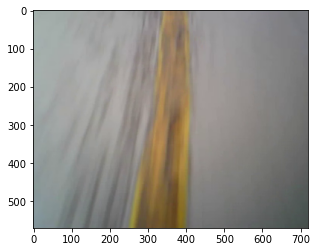

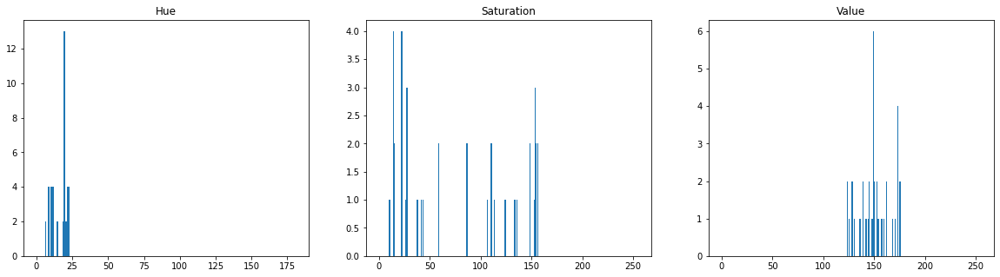

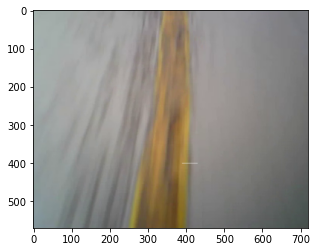

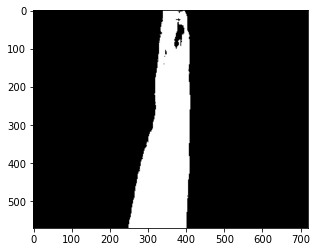

In [7]:
relevantFrames = [399]

imgplot = plt.imshow(cv2.cvtColor(frameArray[399],cv2.COLOR_BGR2RGB))
plt.show()
hsv = cv2.cvtColor(frameArray[399], cv2.COLOR_BGR2HSV)
h,s,v = cv2.split(hsv) 
fig = plt.figure(figsize=(20,5))
fig.add_subplot(1,3,1)
plt.title("Hue")
plt.hist(h[400,390:431],range = (0,181) , bins =180)
fig.add_subplot(1,3,2)
plt.title("Saturation")
plt.hist(s[400,390:431],range = (0,255) , bins =255)
fig.add_subplot(1,3,3)
plt.title("Value")
plt.hist(v[400,390:431],range = (0,255) , bins =255)
plt.show()


imageDots = frameArray[399].copy()
imageDots[400,390:431] = (255,255,255)
imgplot = plt.imshow(cv2.cvtColor(imageDots,cv2.COLOR_BGR2RGB))
plt.show()

imgplot = cv2.cvtColor(frameArray[399],cv2.COLOR_BGR2RGB).copy()

for linha in range(len(s)):
        for coluna in range(len(s[linha])):
            if(s[linha][coluna] > 70 or v[linha][coluna] < 70):
                imgplot[linha][coluna] = 255
                
            else:
                imgplot[linha][coluna] = 0

plt.imshow(imgplot)
plt.show()


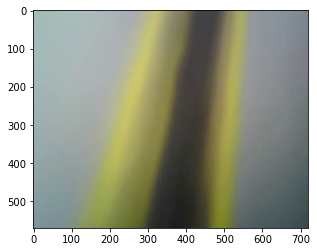

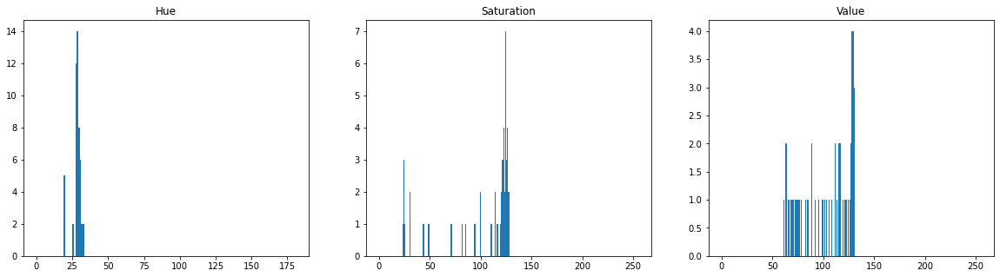

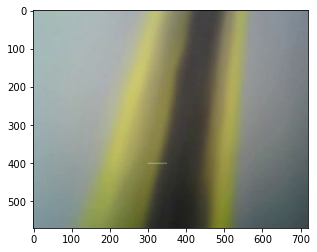

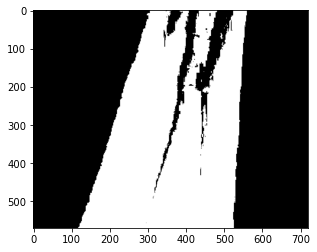

In [8]:
relevantFrames = [146]

imgplot = plt.imshow(cv2.cvtColor(frameArray[146],cv2.COLOR_BGR2RGB))
plt.show()
hsv = cv2.cvtColor(frameArray[146], cv2.COLOR_BGR2HSV)
h,s,v = cv2.split(hsv) 
fig = plt.figure(figsize=(20,5))
fig.add_subplot(1,3,1)
plt.title("Hue")
plt.hist(h[400,300:351],range = (0,181) , bins =180)
fig.add_subplot(1,3,2)
plt.title("Saturation")
plt.hist(s[400,300:351],range = (0,255) , bins =255)
fig.add_subplot(1,3,3)
plt.title("Value")
plt.hist(v[400,300:351],range = (0,255) , bins =255)
plt.show()


imageDots = frameArray[146].copy()
imageDots[400,300:351] = (255,255,255)
imgplot = plt.imshow(cv2.cvtColor(imageDots,cv2.COLOR_BGR2RGB))
plt.show()

imgplot = cv2.cvtColor(frameArray[146],cv2.COLOR_BGR2RGB).copy()

for linha in range(len(s)):
        for coluna in range(len(s[linha])):
            if(s[linha][coluna] > 70 or v[linha][coluna] < 70):
                imgplot[linha][coluna] = 255
                
            else:
                imgplot[linha][coluna] = 0

plt.imshow(imgplot)
plt.show()

## Teste Método Otsu

Snippet de codigo retirado de https://learnopencv.com/otsu-thresholding-with-opencv/ 

### Teste metodo otsu com grayscale

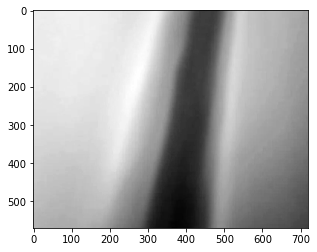

Otsu's algorithm implementation thresholding result:  118.201171875


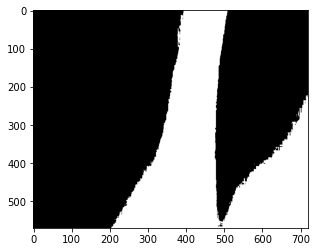

In [9]:
# Set total number of bins in the histogram

gray = cv2.cvtColor(frameArray[146], cv2.COLOR_BGR2GRAY)
gray = gray.copy()
plt.imshow(gray,cmap=plt.get_cmap('gray'))
plt.show()

bins_num = 256

# Get the image histogram
hist, bin_edges = np.histogram(gray, bins=bins_num)

# Get normalized histogram if it is required

hist = np.divide(hist.ravel(), hist.max())

# Calculate centers of bins
bin_mids = (bin_edges[:-1] + bin_edges[1:]) / 2.

# Iterate over all thresholds (indices) and get the probabilities w1(t), w2(t)
weight1 = np.cumsum(hist)
weight2 = np.cumsum(hist[::-1])[::-1]

# Get the class means mu0(t)
mean1 = np.cumsum(hist * bin_mids) / weight1
# Get the class means mu1(t)
mean2 = (np.cumsum((hist * bin_mids)[::-1]) / weight2[::-1])[::-1]

inter_class_variance = weight1[:-1] * weight2[1:] * (mean1[:-1] - mean2[1:]) ** 2

# Maximize the inter_class_variance function val
index_of_max_val = np.argmax(inter_class_variance)

threshold = bin_mids[:-1][index_of_max_val]
print("Otsu's algorithm implementation thresholding result: ", threshold)



    
for linha in range(len(gray)):
    for coluna in range(len(gray[linha])):
        if gray[linha,coluna] <=threshold:
            gray[linha,coluna] = 255
        else:
            gray[linha,coluna] = 0
            

plt.imshow(gray,cmap=plt.get_cmap('gray'))
plt.show()

### Teste método otsu executado sobre os componentes HSV

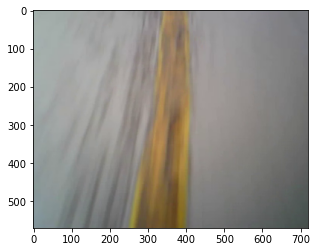

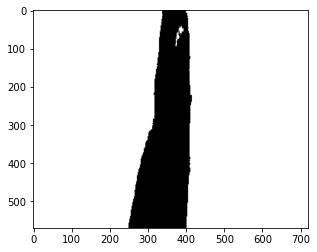

In [10]:
imgplot = plt.imshow(cv2.cvtColor(frameArray[399],cv2.COLOR_BGR2RGB))
plt.show()
hsv = cv2.cvtColor(frameArray[399], cv2.COLOR_BGR2HSV)
h,s,v = cv2.split(hsv) 

bins_num = [160,256,256]

components = [h,s,v]




def otsuThresh(components):
    i= 0
    max_val = 0
    thres = []
    indexc = 0
    for c in components:
        # Get the image histogram
        hist, bin_edges = np.histogram(c[400,:], bins=bins_num[i])
        
        # Get normalized histogram if it is required

        hist = np.divide(hist.ravel(), hist.max())

        # Calculate centers of bins
        bin_mids = (bin_edges[:-1] + bin_edges[1:]) / 2.

        # Iterate over all thresholds (indices) and get the probabilities w1(t), w2(t)
        weight1 = np.cumsum(hist)
        weight2 = np.cumsum(hist[::-1])[::-1]

        # Get the class means mu0(t)
        mean1 = np.cumsum(hist * bin_mids) / weight1
        # Get the class means mu1(t)
        mean2 = (np.cumsum((hist * bin_mids)[::-1]) / weight2[::-1])[::-1]

        inter_class_variance = weight1[:-1] * weight2[1:] * (mean1[:-1] - mean2[1:]) ** 2

        # Maximize the inter_class_variance function val
        index_of_max_val = np.argmax(inter_class_variance)
        #print(np.max(inter_class_variance))
        if(max_val < np.max(inter_class_variance)):
            max_val = np.max(inter_class_variance)
            indexc = i
            
        i += 1
        threshold = bin_mids[:-1][index_of_max_val]
        #print("Otsu's algorithm implementation thresholding result: ", threshold)
        thres.append(threshold)
    return thres,indexc
    
thresholds,indexc = otsuThresh(components)
imageCopy = cv2.cvtColor(frameArray[399],cv2.COLOR_BGR2RGB).copy()
for linha in range(len(h)):
    for coluna in range(len(h[linha])):
        if s[linha,coluna] <= thresholds[1]:
            imageCopy[linha,coluna] = 255
        else:
            imageCopy[linha,coluna] = 0
            
plt.imshow(imageCopy)
plt.show()
    

Após testados com o uso de 3 thresholds diferentes em simultaneo foi concluido que é melhor opção selecionar quais as componentes cuja a variação entre elas seja maior de modo a ter um threshold que melhor distinga o chão da linha, para tal foi obtido os valores máximos de variação entre classes ( neste caso chão e linha ) e é apenas aplicado o filtro na componente cuja a variancia inter classe seja maior.

### Teste método otsu aplicado sobre a componente com mais variancia inter classe

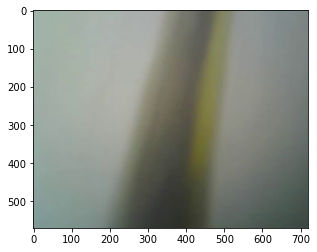

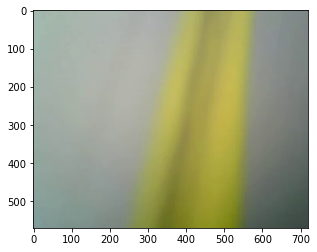

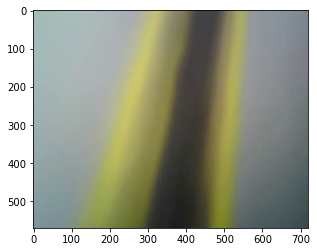

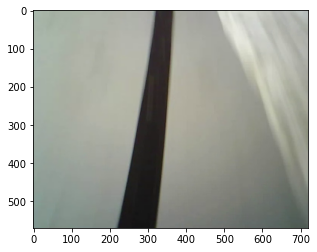

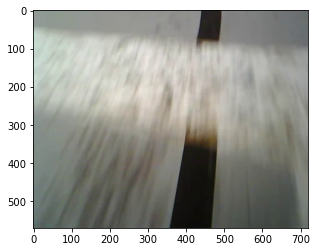

...

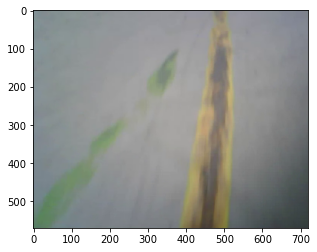

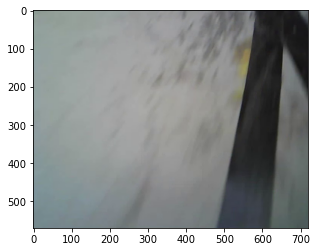

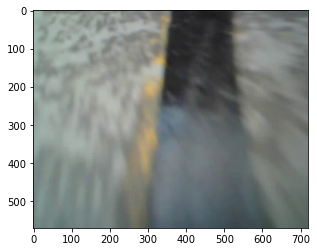

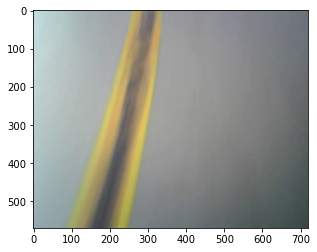

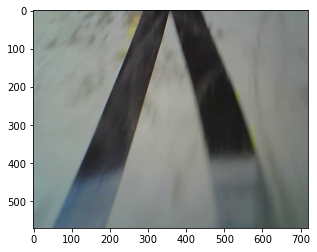

In [11]:
relevantFrames = [142,143,146,367,379,387,393,399,444,480,486,822,876]

for i in relevantFrames:
    imgplot = plt.imshow(cv2.cvtColor(frameArray[i],cv2.COLOR_BGR2RGB))
    plt.show()

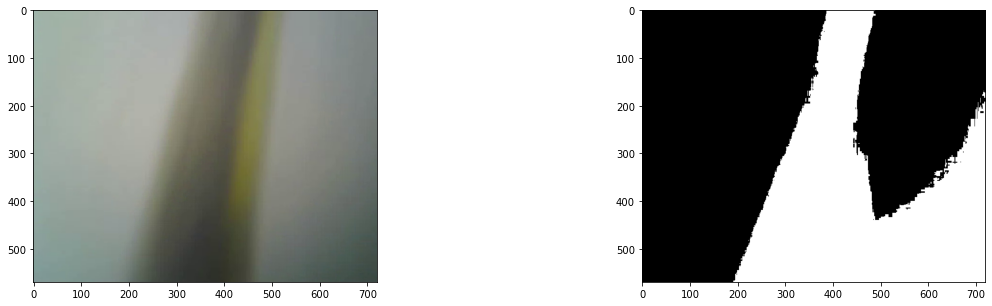

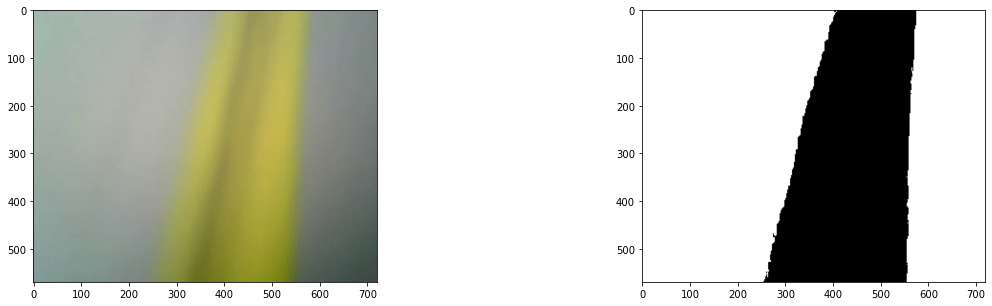

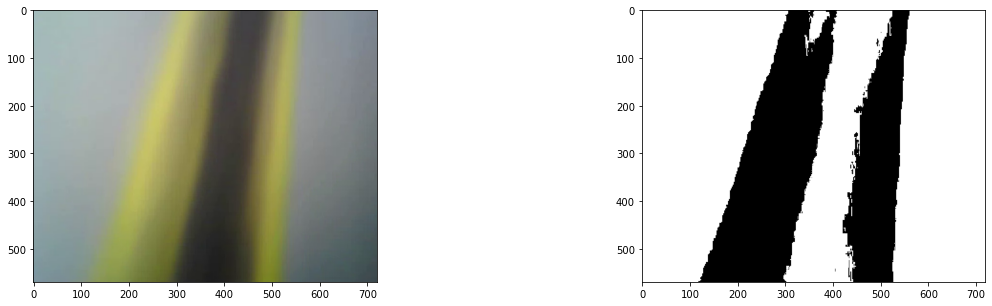

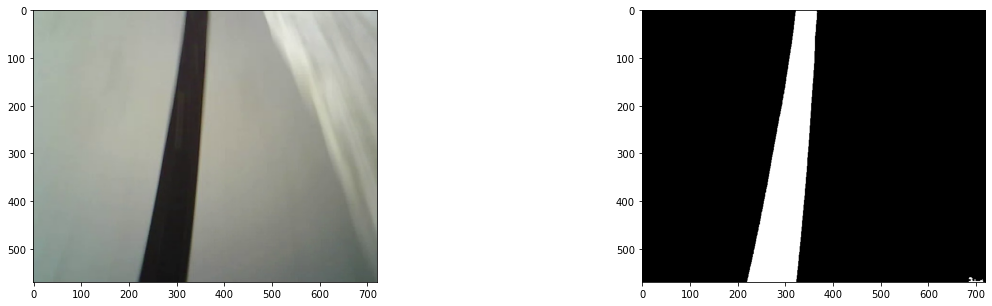

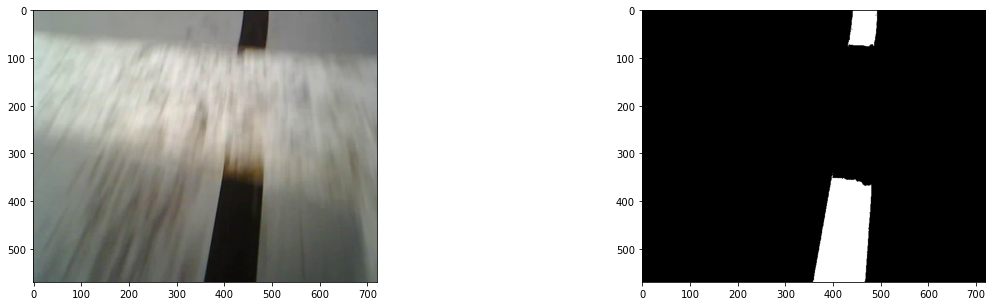

...

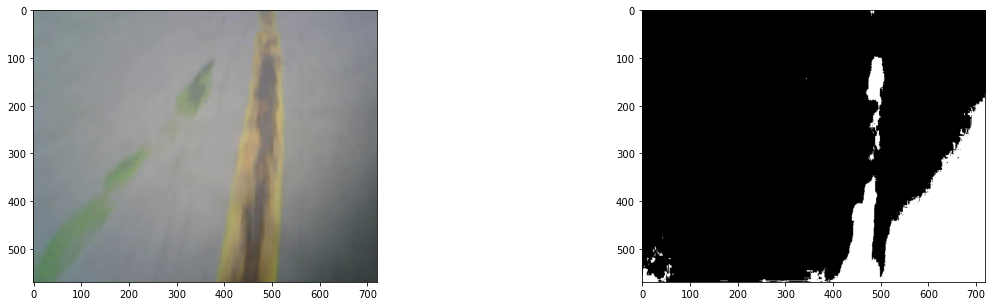

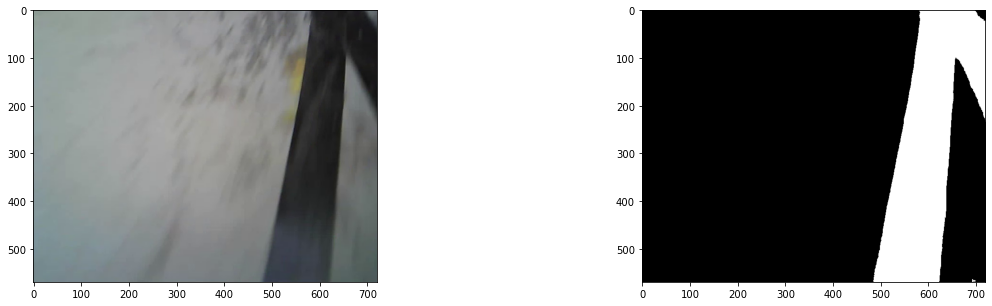

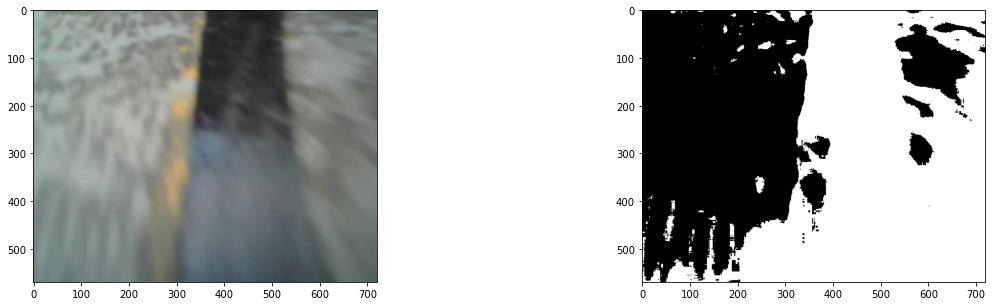

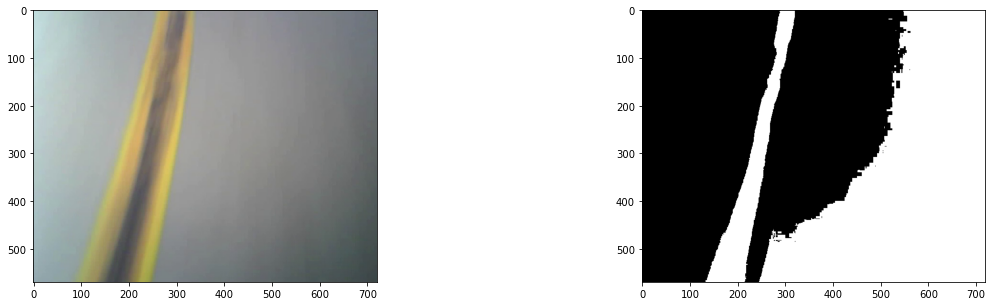

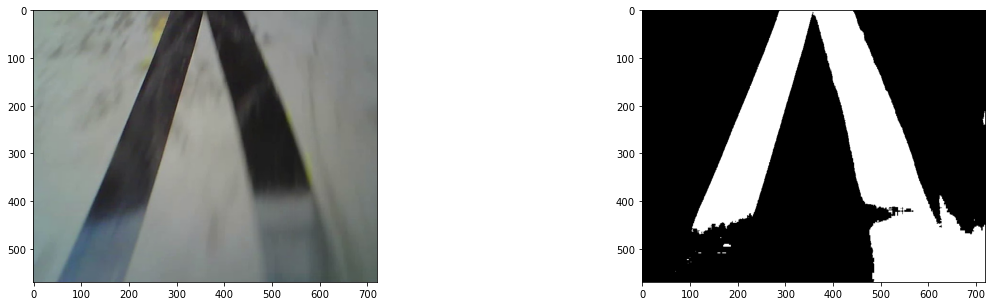

In [12]:
relevantFrames = [142,143,146,367,379,387,393,399,444,480,486,822,876]
for i in relevantFrames:

    hsv = cv2.cvtColor(frameArray[i], cv2.COLOR_BGR2HSV)
    h,s,v = cv2.split(hsv) 

    bins_num = [160,256,256]

    components = [h,s,v]
    thresholds,indexc = otsuThresh(components)
    
    imageCopy = cv2.cvtColor(frameArray[i],cv2.COLOR_BGR2RGB).copy()
    #print(indexc)
    for linha in range(len(h)):
        for coluna in range(len(h[linha])):
            if(indexc == 0):  
                if h[linha,coluna] <=thresholds[0]:
                    imageCopy[linha,coluna] = 255
                else:
                    imageCopy[linha,coluna] = 0
            elif(indexc == 1):  
                if s[linha,coluna] <=thresholds[1]:
                    imageCopy[linha,coluna] = 255
                else:
                    imageCopy[linha,coluna] = 0
            elif(indexc == 2):  
                if v[linha,coluna] <=thresholds[2]:
                    imageCopy[linha,coluna] = 255
                else:
                    imageCopy[linha,coluna] = 0        
    fig = plt.figure(figsize = (20,5))
    fig.add_subplot(1,2,1)
    plt.imshow(cv2.cvtColor(frameArray[i],cv2.COLOR_BGR2RGB))
    fig.add_subplot(1,2,2)
    plt.imshow(imageCopy)
    plt.show()
    

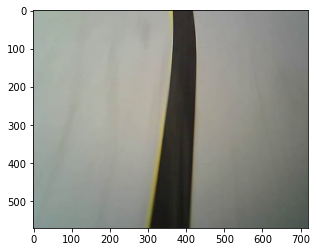

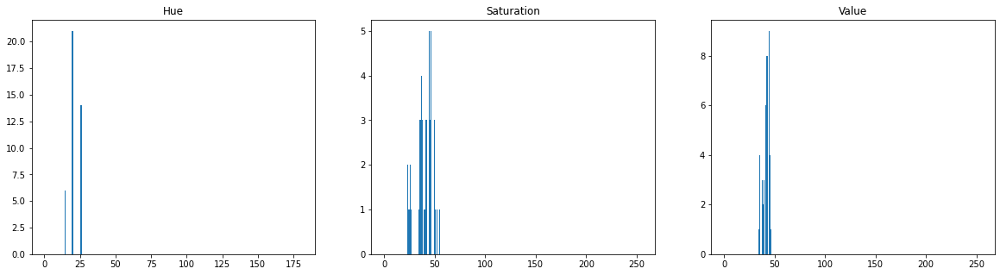

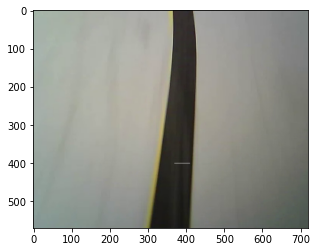

Threshold otsu = 75.173828125
Standard deviation Hue component = 29.08547664081838
Standard deviation Saturation component = 27.097039896330216
Standard deviation Value component = 10.025990421936646
Average line width (px): 76 px


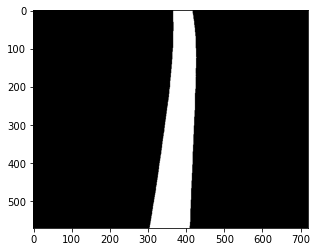

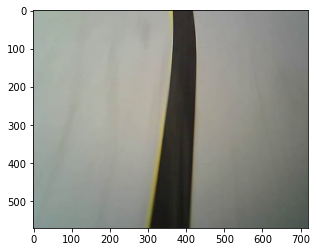

In [13]:
from statsmodels import robust

benchmarkFrameNumber = 393
benchmarkFrame = frameArray[benchmarkFrameNumber].copy()

imgplot = plt.imshow(cv2.cvtColor(benchmarkFrame,cv2.COLOR_BGR2RGB))
plt.show()
hsv = cv2.cvtColor(benchmarkFrame, cv2.COLOR_BGR2HSV)
h,s,v = cv2.split(hsv) 

fig = plt.figure(figsize=(20,5))
fig.add_subplot(1,3,1)
plt.title("Hue")
plt.hist(h[400,370:411],range = (0,181) , bins =180)
fig.add_subplot(1,3,2)
plt.title("Saturation")
plt.hist(s[400,370:411],range = (0,255) , bins =255)
fig.add_subplot(1,3,3)
plt.title("Value")
plt.hist(v[400,370:411],range = (0,255) , bins =255)
plt.show()


bins_num = [160,256,256]

components = [h,s,v]
thresholds,indexc = otsuThresh(components)

imageCopy = cv2.cvtColor(benchmarkFrame,cv2.COLOR_BGR2RGB).copy()
boolMatrix = np.zeros((len(h),len(h[0])))
imageCopy2 = cv2.cvtColor(benchmarkFrame,cv2.COLOR_BGR2RGB).copy()


'''
for linha in range(len(h)):
    for coluna in range(len(h[linha])):
        if h[linha,coluna] <= 55 and v[linha,coluna] <= 52:
            
            imageCopy2[linha,coluna] = 255
        else:
            imageCopy2[linha,coluna] = 0        
'''

#print(indexc)

for linha in range(len(h)):
    for coluna in range(len(h[linha])):
        if(indexc == 0):  
            if h[linha,coluna] <=thresholds[0]:
                imageCopy[linha,coluna] = 255
                boolMatrix[linha,coluna] = 1
            else:
                imageCopy[linha,coluna] = 0
        elif(indexc == 1):  
            if s[linha,coluna] <=thresholds[1]:
                boolMatrix[linha,coluna] = 1
                imageCopy[linha,coluna] = 255
            else:
                imageCopy[linha,coluna] = 0
        elif(indexc == 2):  
            if v[linha,coluna] <=thresholds[2]:
                boolMatrix[linha,coluna] = 1
                imageCopy[linha,coluna] = 255
            else:
                imageCopy[linha,coluna] = 0        

widthArray = []
widthCount = 0
linePixel = []   
for linha in range(len(h)):
    for coluna in range(len(h[linha])):
        if(boolMatrix[linha,coluna] == 1):
            widthCount +=1
            linePixel.append((h[linha,coluna],s[linha,coluna],v[linha,coluna]))
    widthArray.append(widthCount)
    widthCount = 0
    
totalH = []
totalS = []
totalV = []
for i in linePixel:
    totalH.append(i[0])
    totalS.append(i[1])
    totalV.append(i[2])
    
imageDots = benchmarkFrame.copy()
imageDots[400,370:411] = (255,255,255)
imgplot = plt.imshow(cv2.cvtColor(imageDots,cv2.COLOR_BGR2RGB))
plt.show()    
    
print("Threshold otsu = " + str(thresholds[2]))    


'''
print("Average Hue component = " + str(np.mean(np.array(totalH))))
print("Average Saturation component = " +  str(np.mean(np.array(totalS))))
print("Average Value component = " +  str(np.mean(np.array(totalV))))
'''
'''
print("Median Hue component = " + str(np.median(np.array(totalH))))
print("Median Saturation component = " +  str(np.median(np.array(totalS))))
print("Median Value component = " +  str(np.median(np.array(totalV))))

print("MAD Hue component = " + str(robust.mad(np.array(totalH))))
print("MAD Saturation component = " +  str(robust.mad(np.array(totalS))))
print("MAD Value component = " +  str(robust.mad(np.array(totalV))))
'''

print("Standard deviation Hue component = " + str(np.std(np.array(totalH))))
print("Standard deviation Saturation component = " + str(np.std(np.array(totalS))))
print("Standard deviation Value component = " + str(np.std(np.array(totalV))))

#print("Max value Value component = " + str(np.max(np.array(totalV))))

averageWidth = np.mean(np.array(widthArray))
print("Average line width (px): " + str(int(averageWidth)) + " px" )


    

plt.imshow(imageCopy)
plt.show()
plt.imshow(cv2.cvtColor(benchmarkFrame,cv2.COLOR_BGR2RGB))
plt.show()




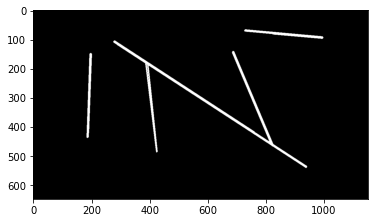

In [14]:
import math

testeHough =  cv2.imread("teste.png")
gray = cv2.cvtColor(testeHough,cv2.COLOR_BGR2GRAY)


hough = np.zeros((len(testeHough),len(testeHough[0])))

lines = cv2.HoughLinesP(gray, 1, np.pi/180, 100, minLineLength=10, maxLineGap=250)
# Draw lines on the image
for line in lines:
    x1, y1, x2, y2 = line[0]
    cv2.line(hough, (x1, y1), (x2, y2), (255, 0, 0), 3)
            
            
plt.imshow(hough,cmap="gray")
plt.show()
        

[121.04062499999999]


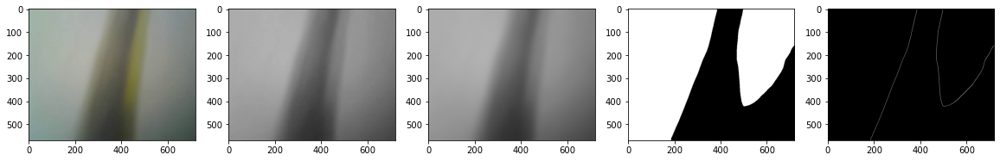

[135.00625]


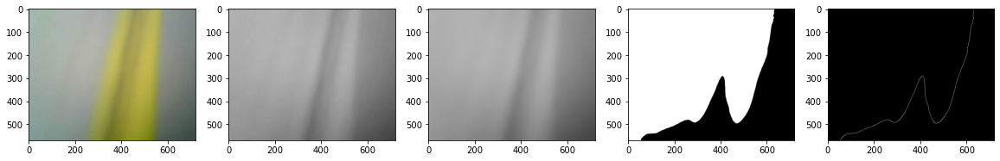

[112.7125]


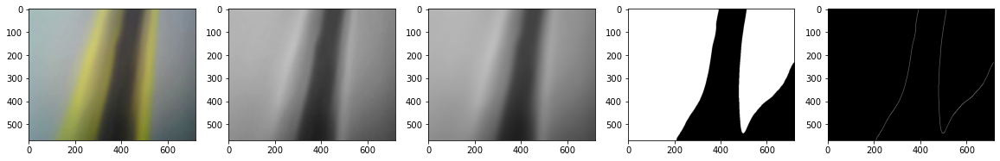

[92.90625]


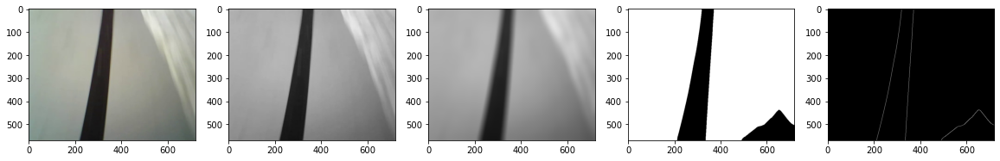

[71.75]


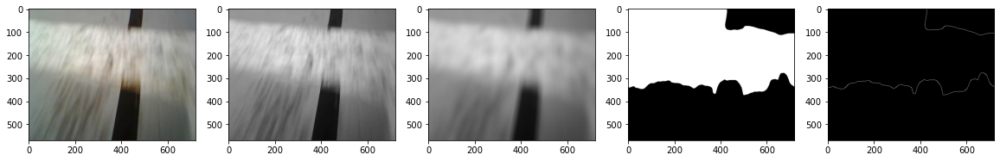

[81.3375]


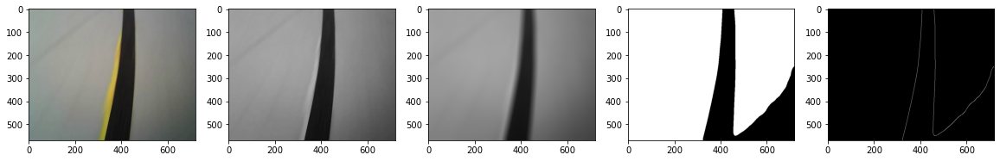

[95.80000000000001]


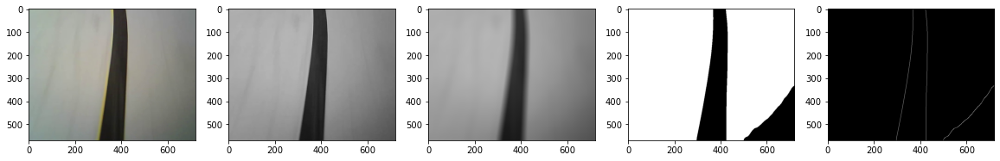

[125.96562499999999]


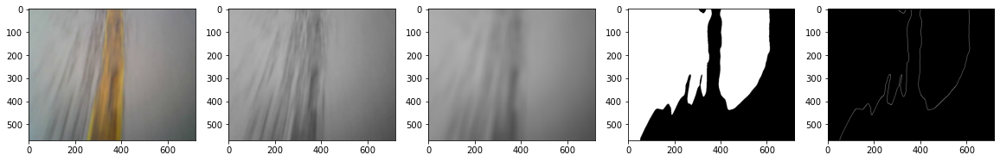

[125.828125]


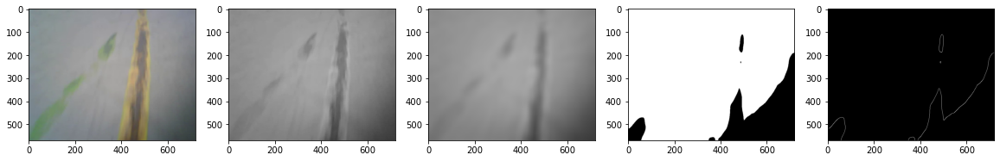

[92.85312499999999]


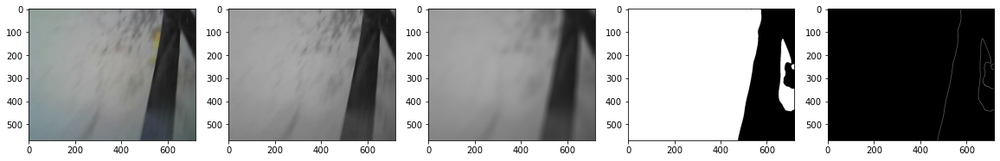

[129.10312499999998]


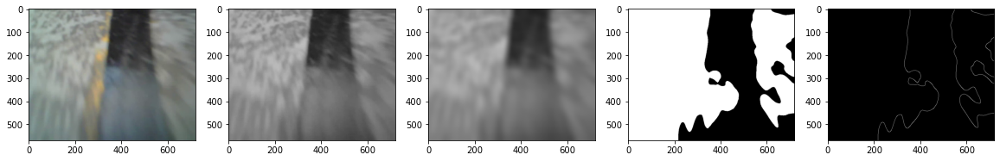

[136.0625]


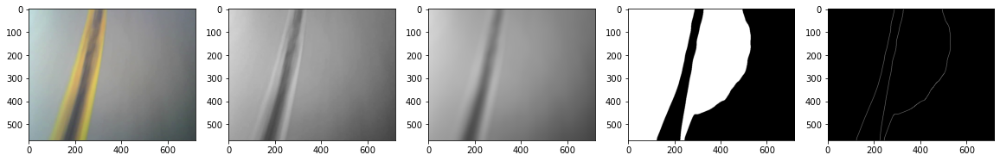

[110.771875]


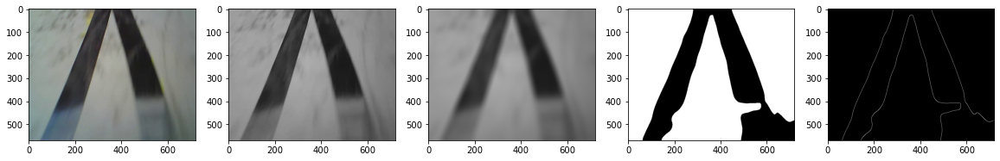

In [16]:

relevantFrames = [142,143,146,367,379,387,393,399,444,480,486,822,876]


for i in relevantFrames:
    grayFrame = cv2.cvtColor(frameArray[i].copy(),cv2.COLOR_BGR2GRAY)
    guassianFrame = cv2.blur(grayFrame.copy(),(30,30),cv2.BORDER_DEFAULT)
    guass = [guassianFrame]


    thresholds,indexc = otsuThresh(guass)
    print(thresholds)

    blur = cv2.bilateralFilter(grayFrame.copy(),9,75,75)
    guassianFrame = cv2.blur(grayFrame.copy(),(30,30),cv2.BORDER_DEFAULT)
    ret,thresh1 = cv2.threshold(guassianFrame,0 , 255 , cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    cannyImg = cv2.Canny(thresh1.copy(),thresholds[0]*0.5,thresholds[0])
   
    #imgplot = plt.imshow(cv2.cvtColor(thresh1,cv2.COLOR_BGR2RGB))
    #plt.show()  

    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,5,1)
    plt.imshow(cv2.cvtColor(frameArray[i].copy(),cv2.COLOR_BGR2RGB))
    fig.add_subplot(1,5,2)
    plt.imshow(cv2.cvtColor(grayFrame,cv2.COLOR_BGR2RGB))
    fig.add_subplot(1,5,3)
    plt.imshow(cv2.cvtColor(guassianFrame,cv2.COLOR_BGR2RGB))
    fig.add_subplot(1,5,4)
    plt.imshow(cv2.cvtColor(thresh1,cv2.COLOR_BGR2RGB))
    fig.add_subplot(1,5,5)
    plt.imshow(cv2.cvtColor(cannyImg,cv2.COLOR_BGR2RGB))
    plt.show()

    """
    lines = cv2.HoughLines(thresh1, 1, np.pi / 180, 10,5,10)
    hough = np.zeros((len(thresh1),len(thresh1[0])))

    if lines is not None:
        for i in range(0, len(lines)):
            rho = lines[i][0][0]
            theta = lines[i][0][1]
            a = math.cos(theta)
            b = math.sin(theta)
            x0 = a * rho
            y0 = b * rho

            pt1 = (int(x0 + 1000*(-b)), int(y0 + 1000*(a)))
            pt2 = (int(x0 - 1000*(-b)), int(y0 - 1000*(a)))
            print("(Ponto Inicial , Ponto Final) : "+str(pt1)+ " " + str(pt2))
            cv2.line(hough, pt1, pt2, (0,0,255), 3, cv2.LINE_AA)
          
    hough = np.zeros((len(cannyImg),len(cannyImg[0])))
    
    lines = cv2.HoughLinesP(cannyImg, 1, np.pi/180, 100, minLineLength=5, maxLineGap=250)
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(hough, (x1, y1), (x2, y2), (255, 0, 0), 3)


    #cnts, hierarchy = cv2.findContours(hough, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
    plt.imshow(hough,cmap="gray")
    plt.show()
    """  

Testes com threshold por mediana (sugestão de Michael Burdinov https://stackoverflow.com/questions/26671027/how-to-chose-the-optimal-hsv-values-for-inrange-thresholding-in-opencv ) :

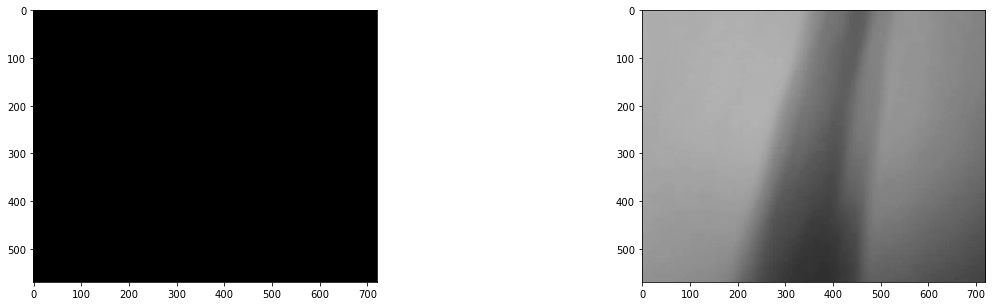

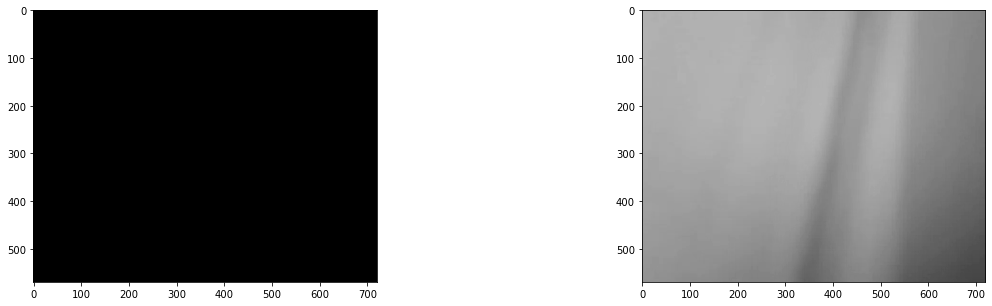

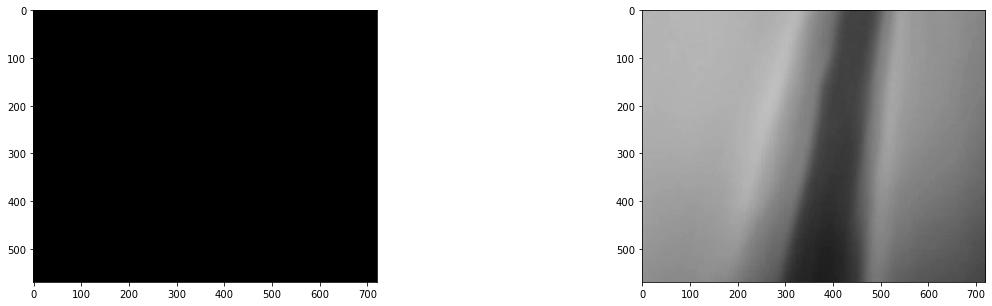

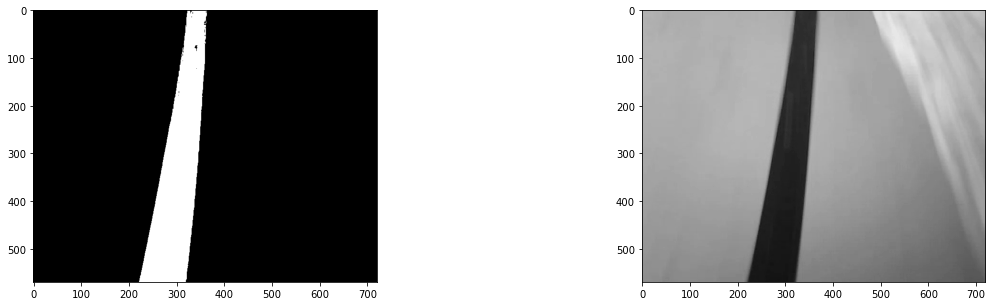

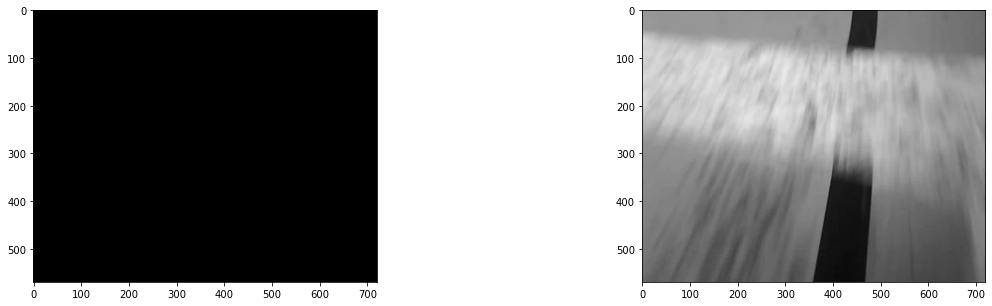

...

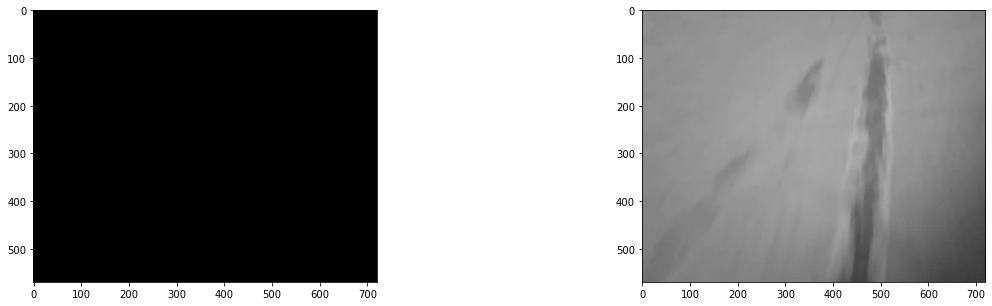

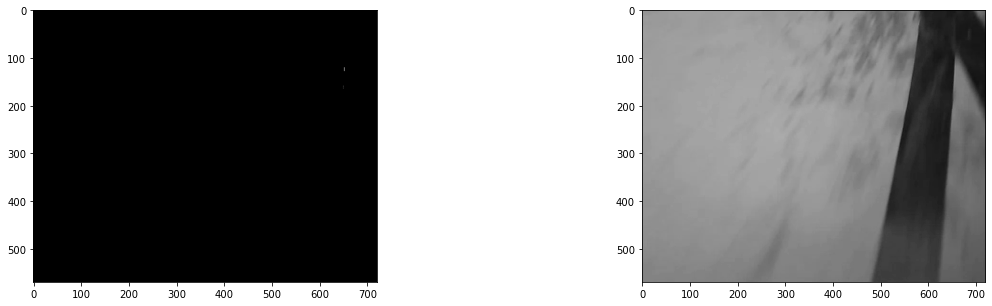

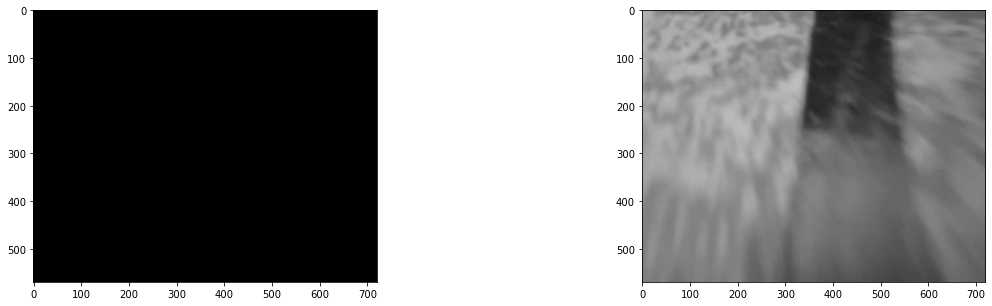

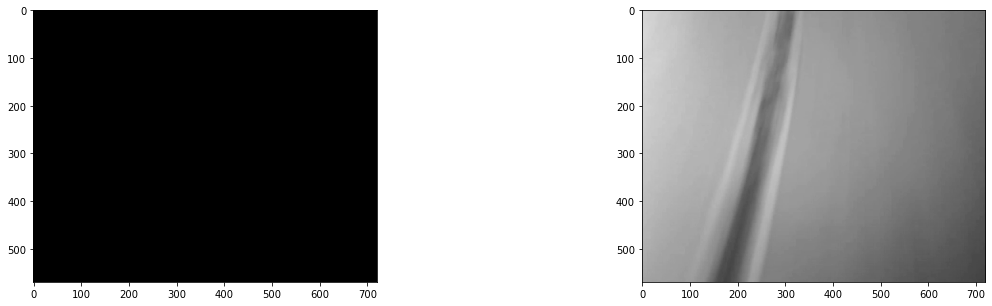

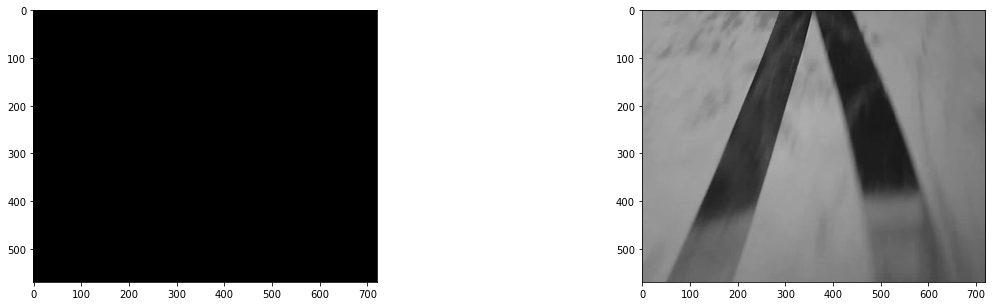

In [17]:
def backgroundFilterMichael(img,median,mad,k = 1):
    imgCopy = np.zeros((len(img),len(img[0])))
    for linha in range(len(img)):
        for coluna in range(len(img[linha])):
            if img[linha,coluna] >= (median - k * mad) and img[linha,coluna] <= (median + k * mad) :
                imgCopy[linha,coluna] = 0
                
            else:
                imgCopy[linha,coluna] = 255


    return imgCopy
                

for i in relevantFrames:
    gray = np.array(cv2.cvtColor(frameArray[i].copy(),cv2.COLOR_BGR2GRAY))
    median = np.median(gray)
    mad = robust.mad(gray)
    fig = plt.figure(figsize = (20,5))
    fig.add_subplot(1,2,1)
    plt.imshow(backgroundFilterMichael(gray,median,mad[400],15), cmap='gray', vmin=0, vmax=255)

    fig.add_subplot(1,2,2)
    plt.imshow(gray, cmap='gray', vmin=0, vmax=255)
    plt.show()

Muito específico para que funcione ao que aparenta, não parecer muito rebusto.
Foram feitos mais testes seguindo heatmaps para melhor encontrar uma relação entre componentes

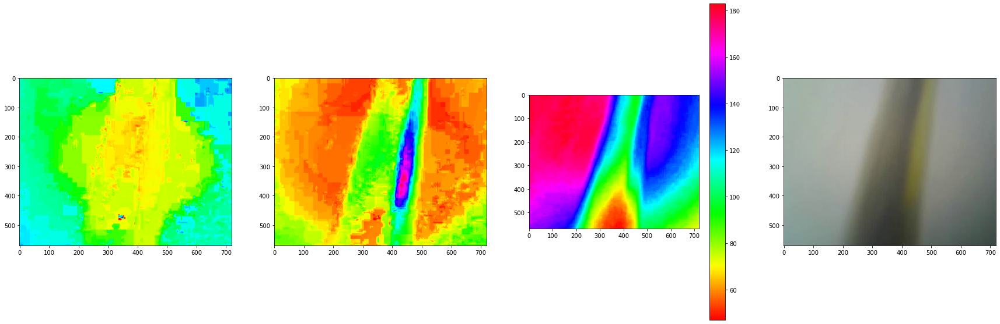

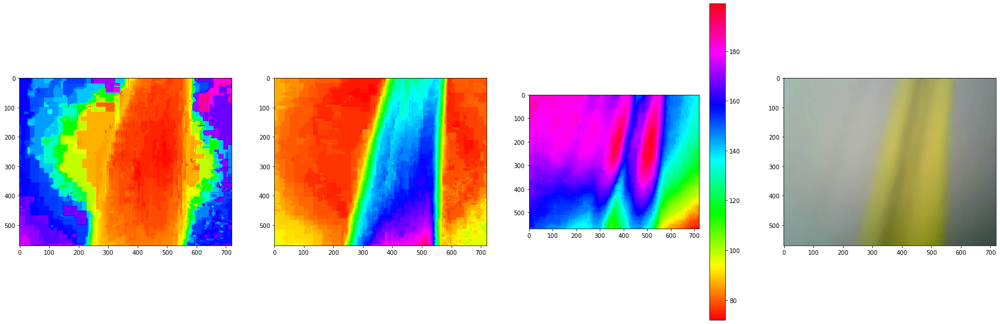

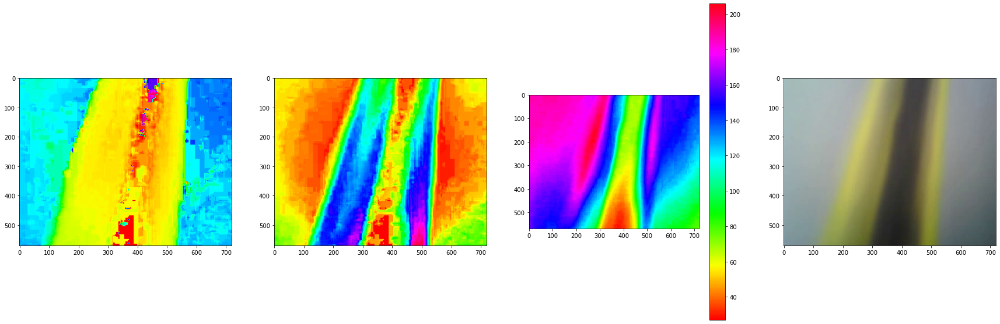

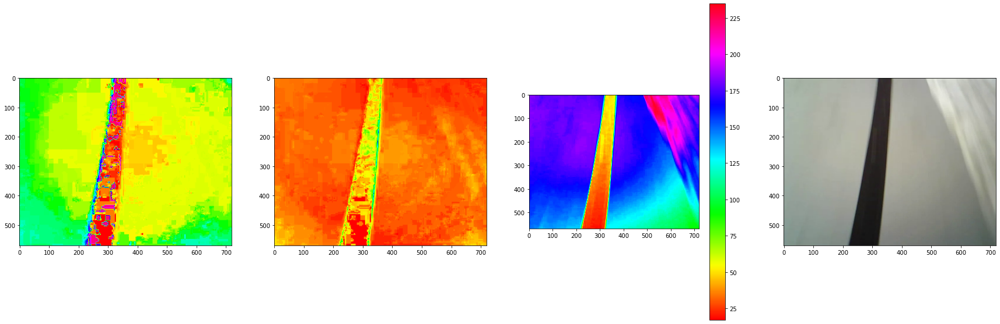

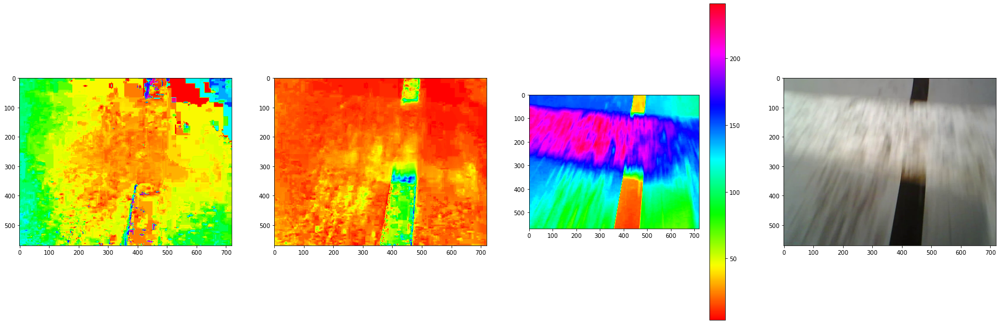

...

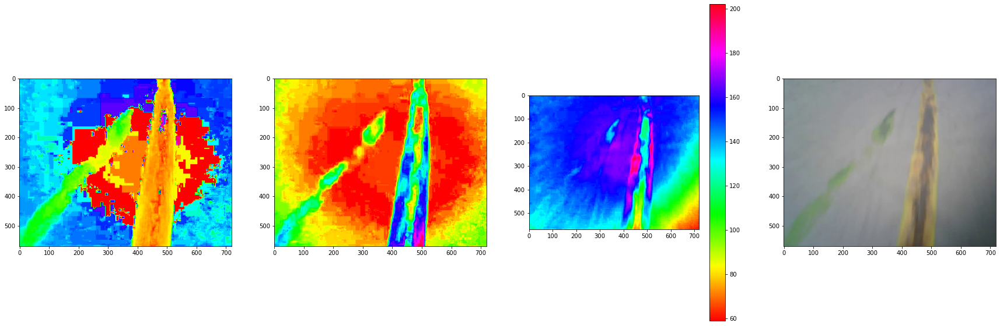

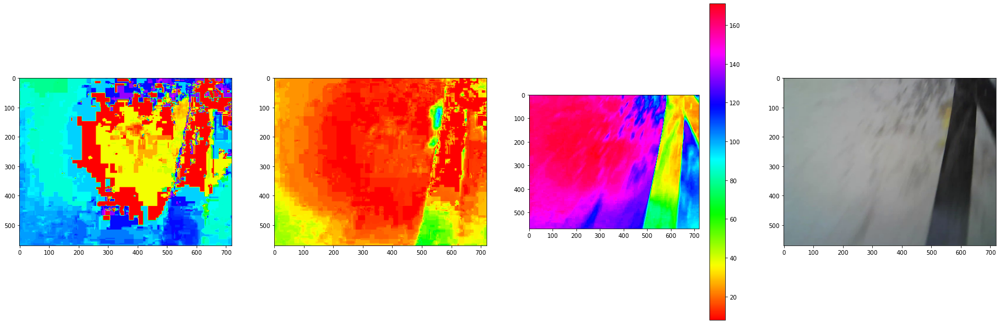

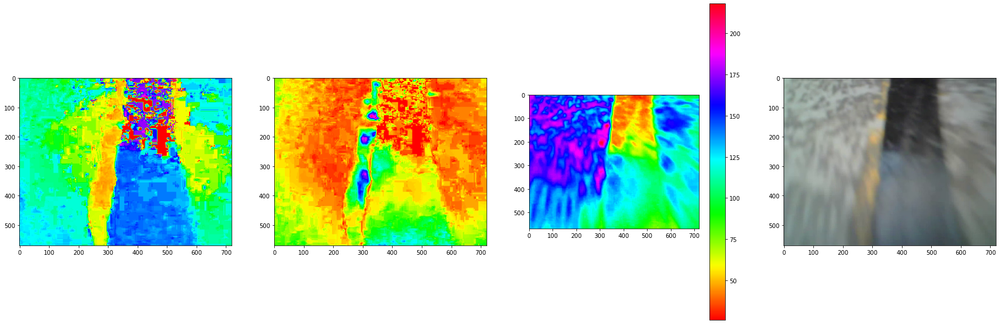

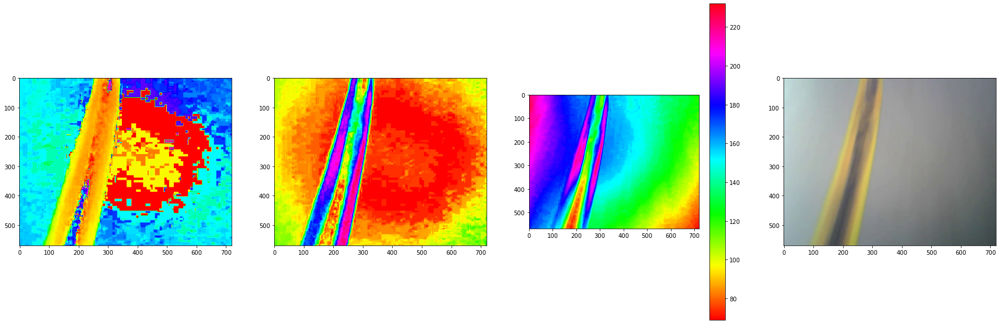

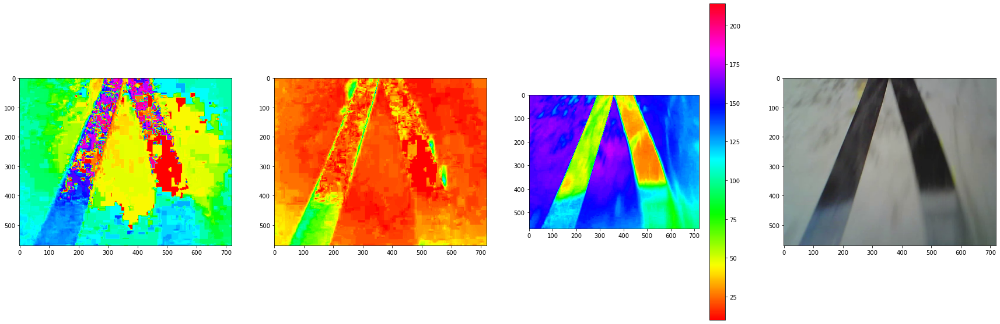

In [18]:
from skimage.filters import threshold_yen
from skimage.exposure import rescale_intensity

for i in relevantFrames:
    
    hsv = cv2.cvtColor(frameArray[i].copy(), cv2.COLOR_BGR2HSV)
    h,s,v = cv2.split(hsv) 

    fig, ax = plt.subplots(1,4,figsize=(30,10))
    im = ax[0].imshow(h,cmap='hsv')
    im = ax[1].imshow(s,cmap='hsv')
    im = ax[2].imshow(v,cmap='hsv')
    fig.colorbar(im,ax=ax[2])
    ax[3].imshow(cv2.cvtColor(frameArray[i].copy(), cv2.COLOR_BGR2RGB))

#plt.show()



### Teste correção de luminosidade e contraste
Código de 
https://stackoverflow.com/questions/56905592/automatic-contrast-and-brightness-adjustment-of-a-color-photo-of-a-sheet-of-pape

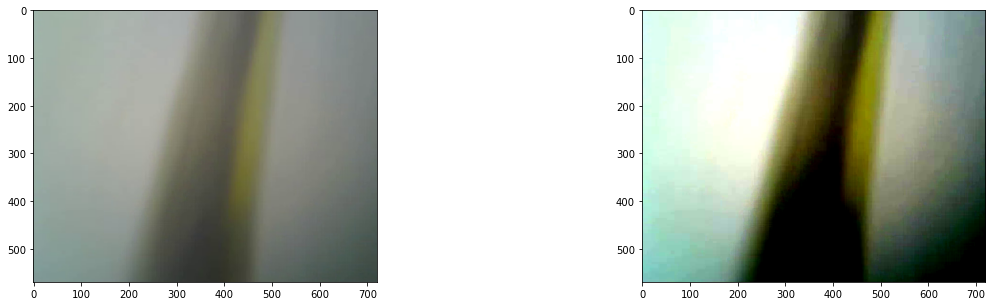

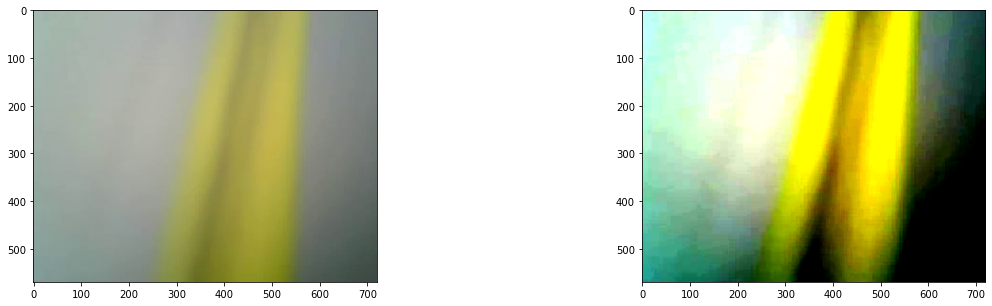

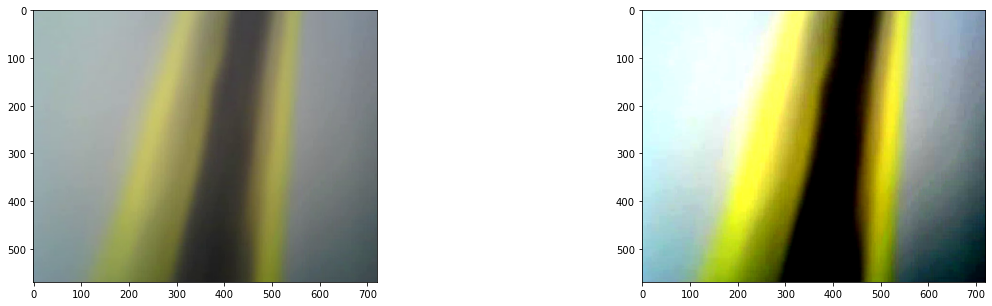

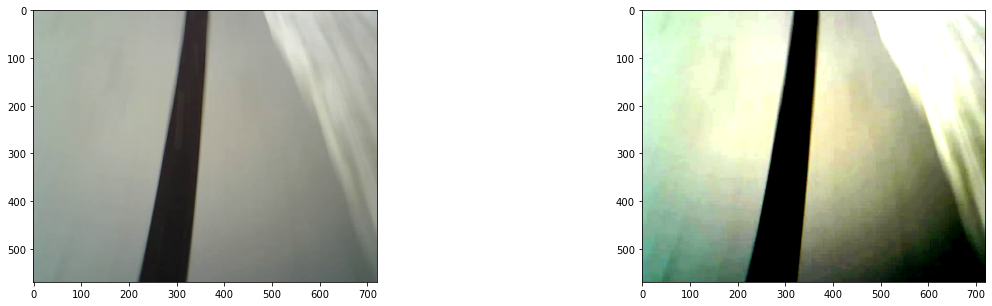

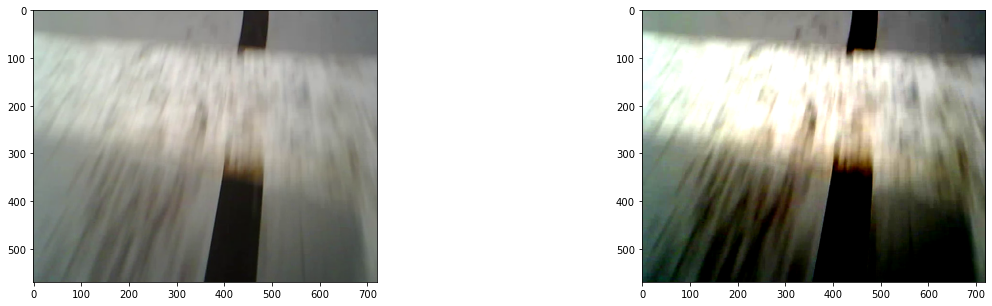

...

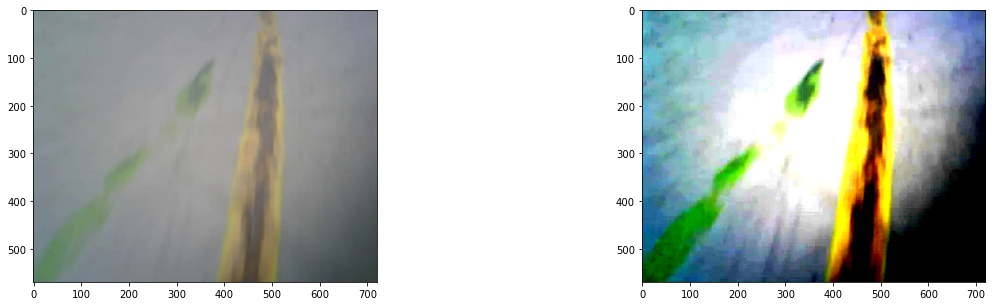

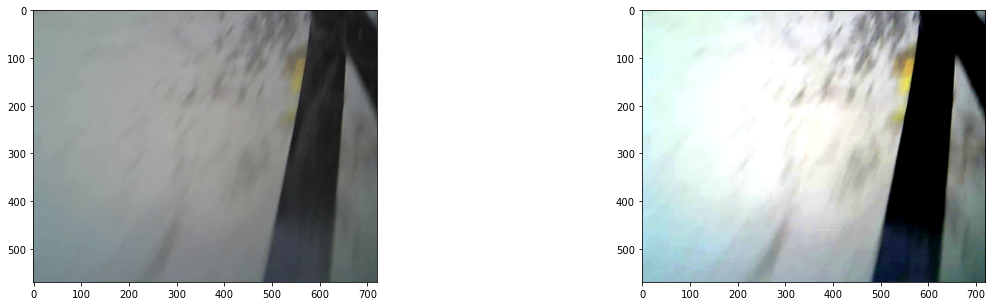

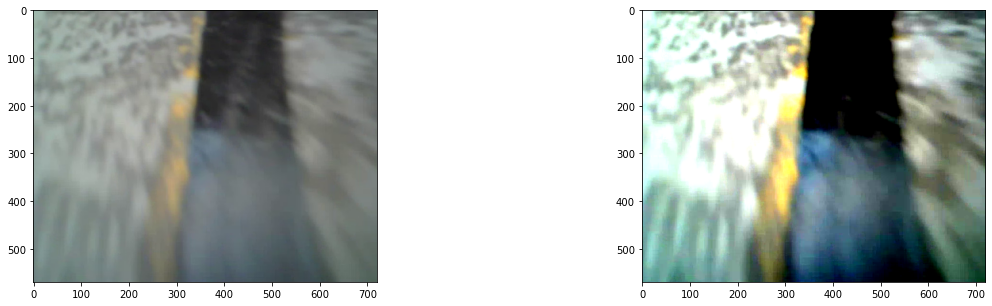

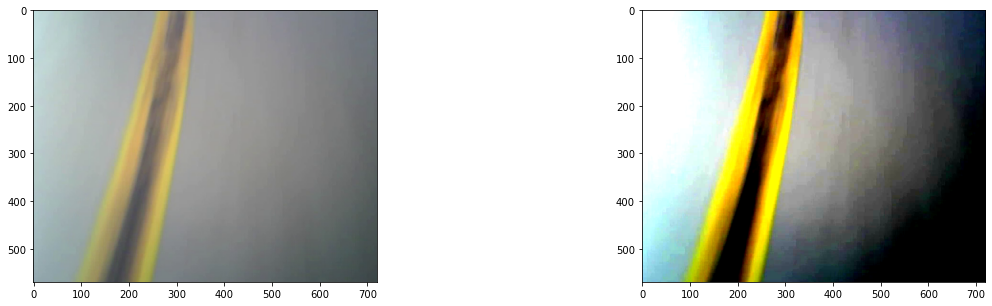

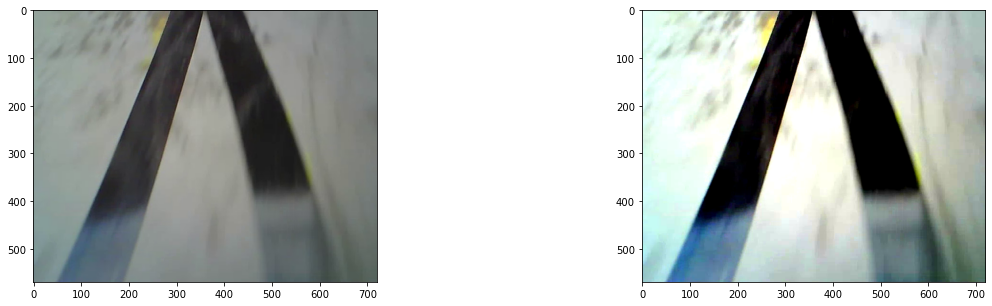

In [19]:
def convertScale(img, alpha, beta):
    new_img = img * alpha + beta
    new_img[new_img < 0] = 0
    new_img[new_img > 255] = 255
    return new_img.astype(np.uint8)

def automatic_brightness_and_contrast(image, clip_hist_percent=25):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Calculate grayscale histogram
    hist = cv2.calcHist([gray],[0],None,[256],[0,256])
    hist_size = len(hist)

    # Calculate cumulative distribution from the histogram
    accumulator = []
    accumulator.append(float(hist[0]))
    for index in range(1, hist_size):
        accumulator.append(accumulator[index -1] + float(hist[index]))
    # Locate points to clip
    maximum = accumulator[-1]
    clip_hist_percent *= (maximum/100.0)
    clip_hist_percent /= 2.0
    # Locate left cut
    minimum_gray = 0
    while accumulator[minimum_gray] < clip_hist_percent:
        minimum_gray += 1
    # Locate right cut
    maximum_gray = hist_size -1
    while accumulator[maximum_gray] >= (maximum - clip_hist_percent):
        maximum_gray -= 1
    # Calculate alpha and beta values
    alpha = 255 / (maximum_gray - minimum_gray)
    beta = -minimum_gray * alpha
    auto_result = convertScale(image, alpha=alpha, beta=beta)
    return (auto_result, alpha, beta)

for i in relevantFrames:
    auto_result, alpha, beta = automatic_brightness_and_contrast(frameArray[i].copy())
    fig, ax = plt.subplots(1,2,figsize=(20,5))
    ax[0].imshow(cv2.cvtColor(frameArray[i],cv2.COLOR_BGR2RGB))
    ax[1].imshow(cv2.cvtColor(auto_result,cv2.COLOR_BGR2RGB))


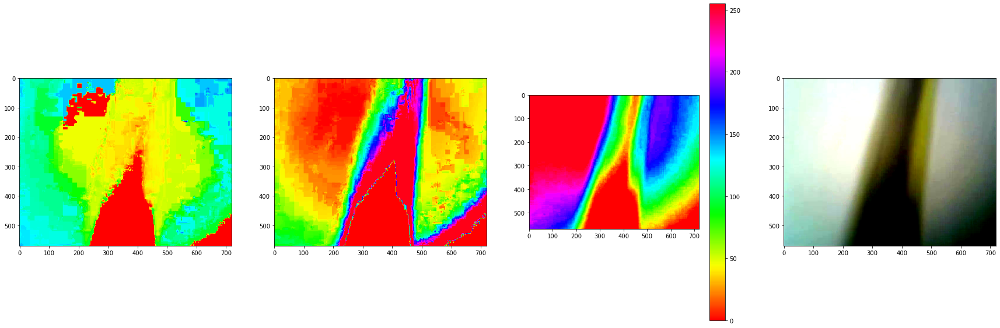

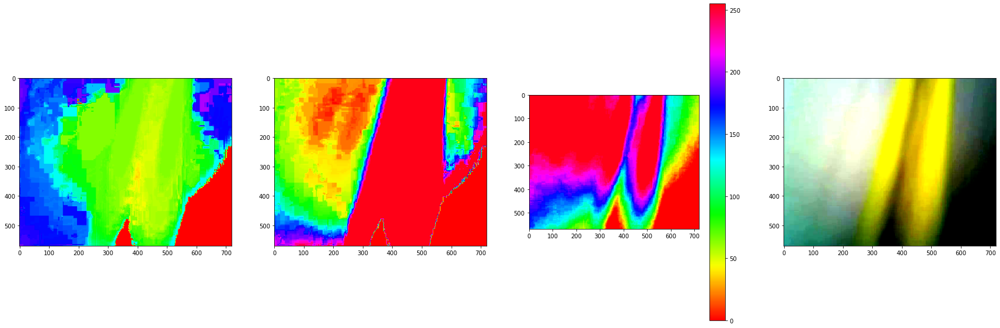

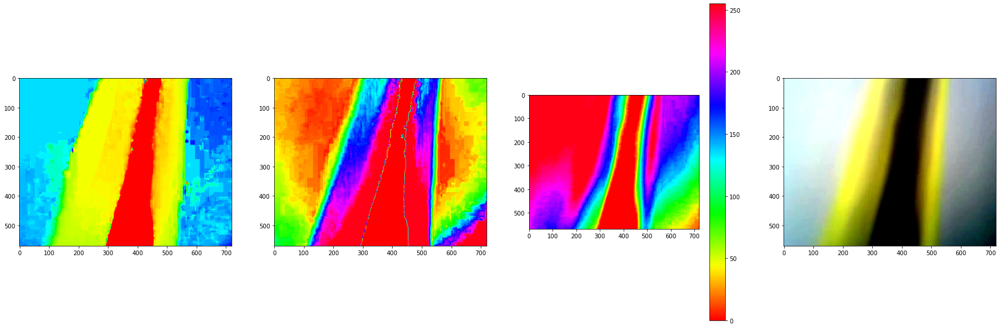

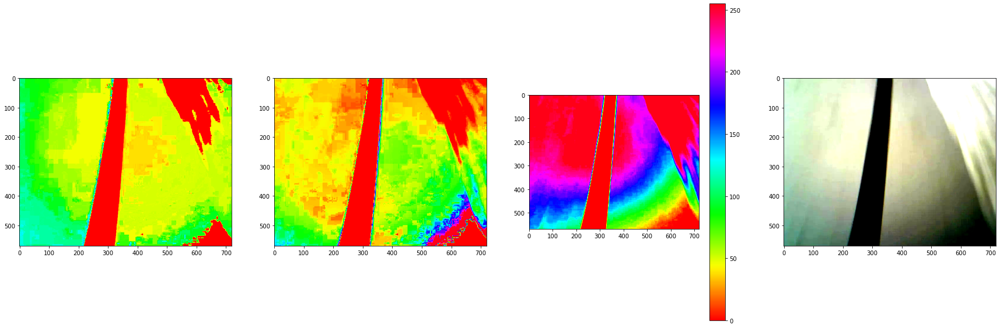

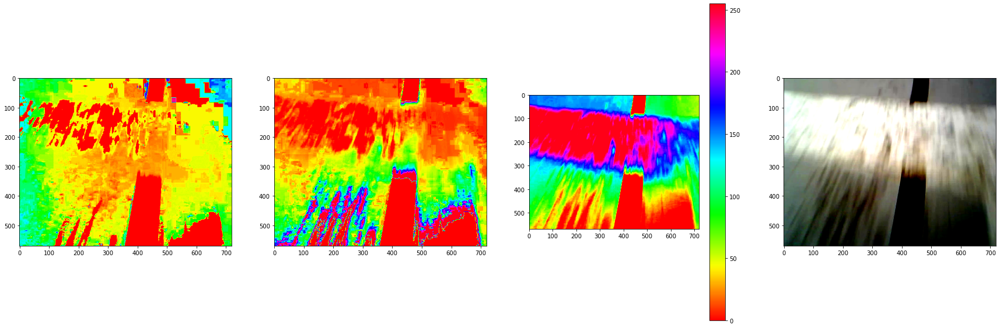

...

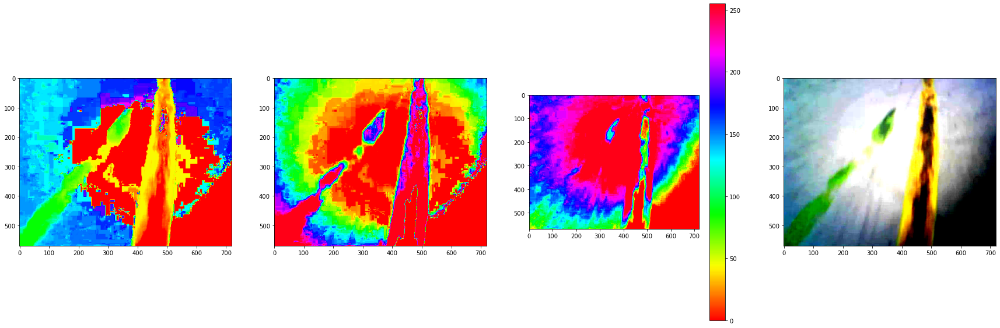

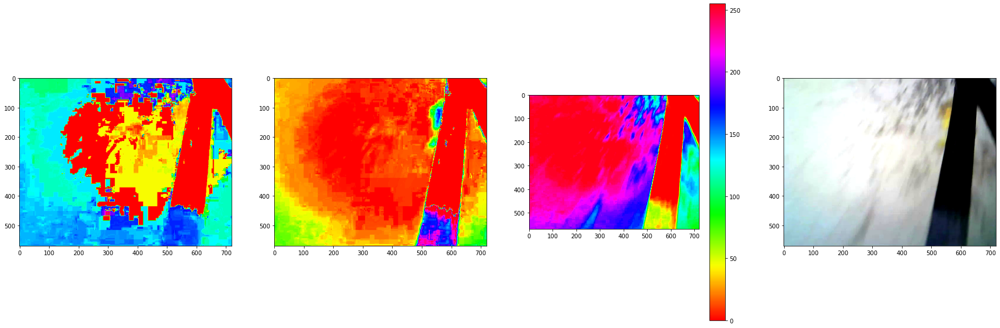

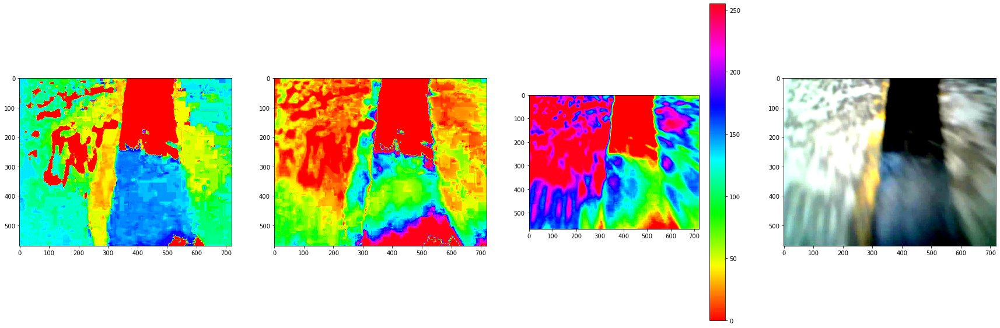

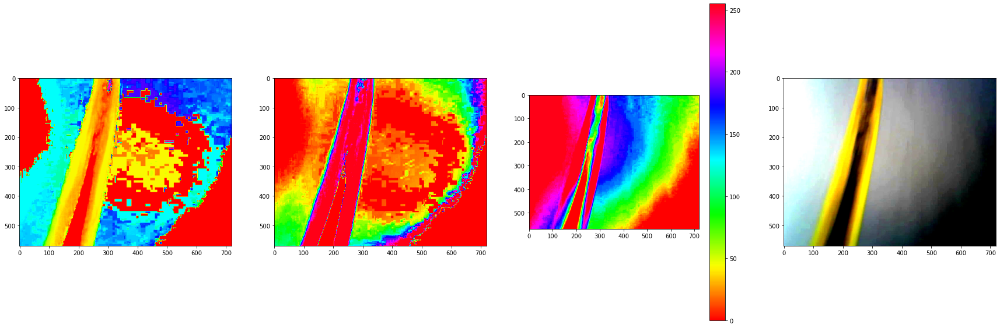

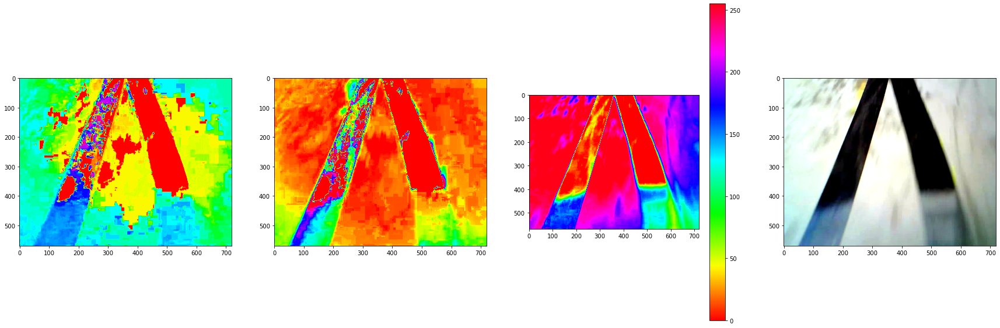

In [20]:
for i in relevantFrames:
    auto_result, alpha, beta = automatic_brightness_and_contrast(frameArray[i].copy())
    hsv = cv2.cvtColor(auto_result, cv2.COLOR_BGR2HSV)
    h,s,v = cv2.split(hsv) 

    fig, ax = plt.subplots(1,4,figsize=(30,10))
    im = ax[0].imshow(h,cmap='hsv')
    im = ax[1].imshow(s,cmap='hsv')
    im = ax[2].imshow(v,cmap='hsv')
    fig.colorbar(im,ax=ax[2])
    ax[3].imshow(cv2.cvtColor(auto_result, cv2.COLOR_BGR2RGB))

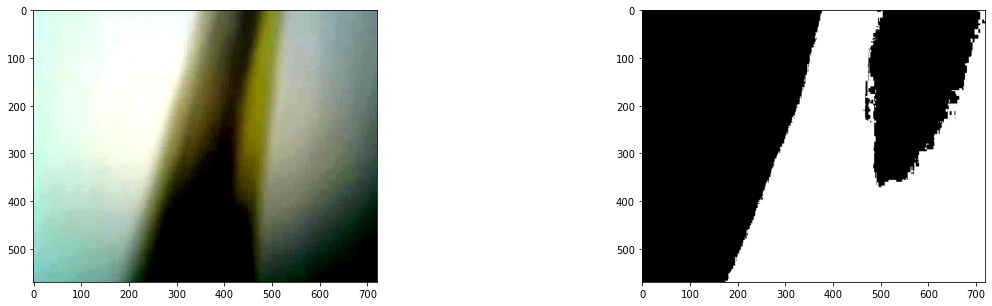

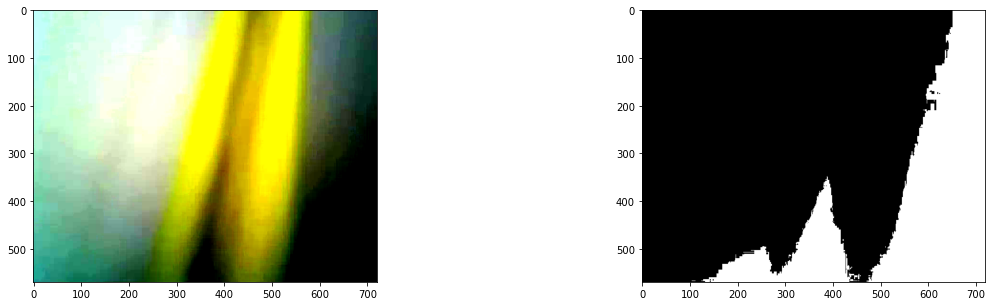

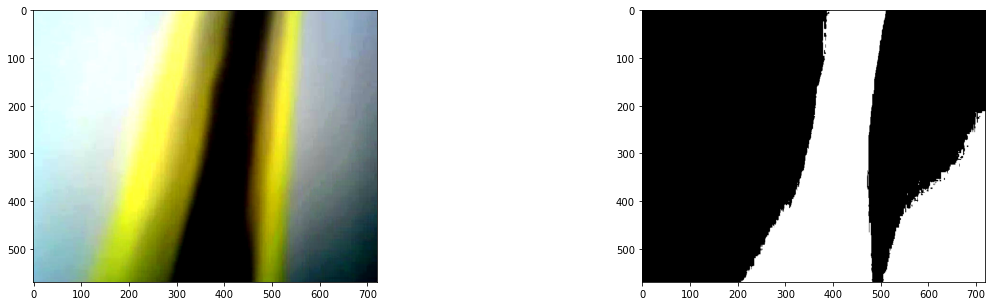

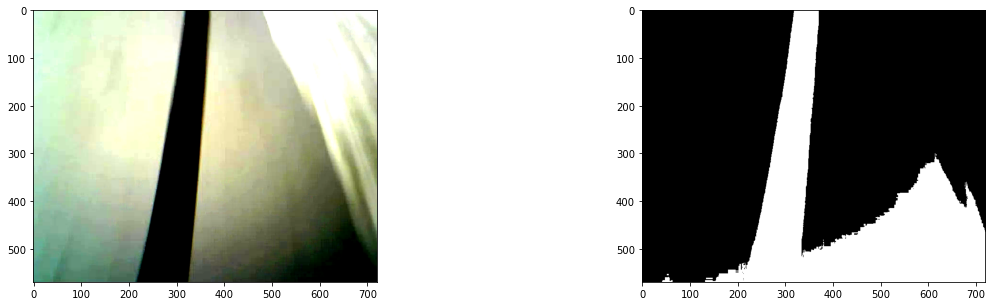

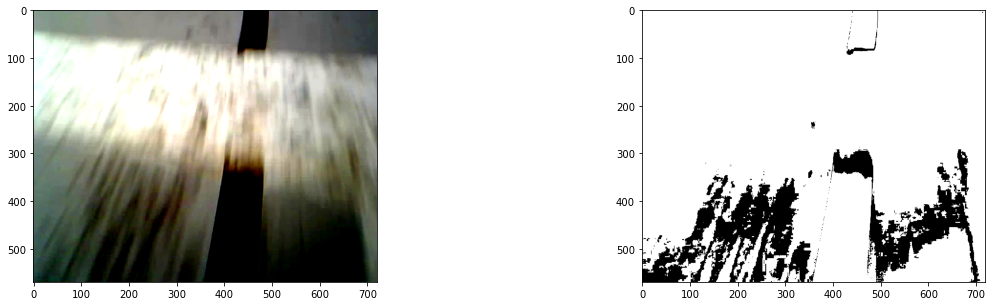

...

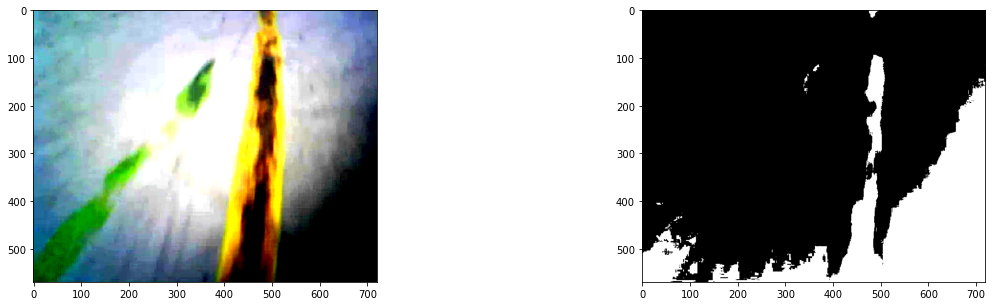

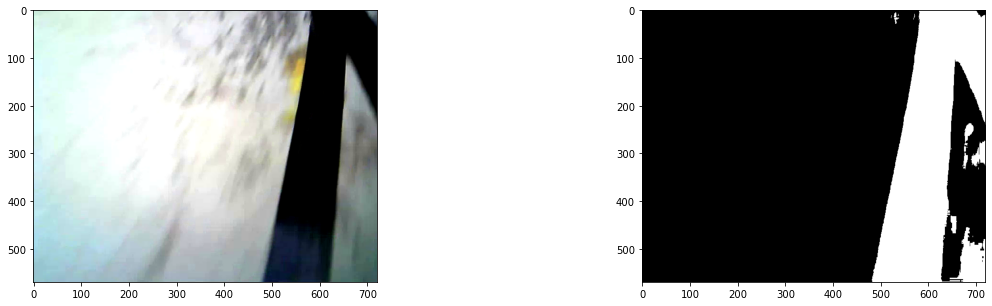

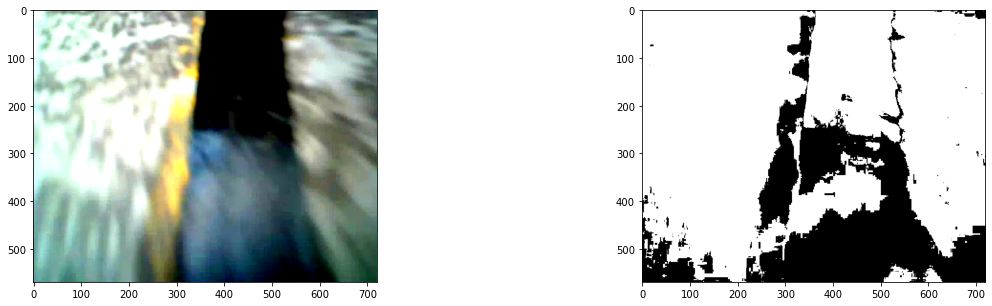

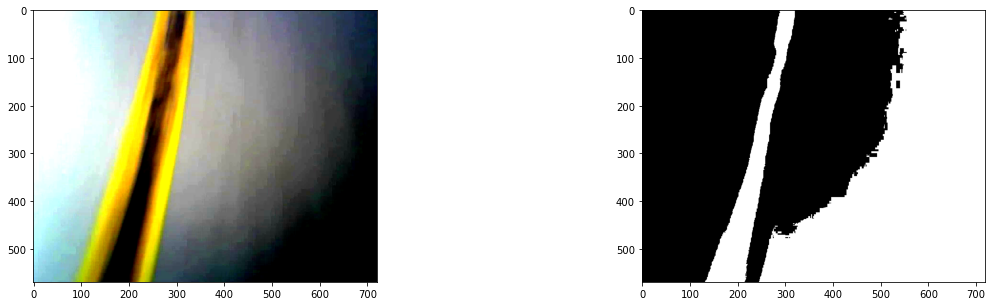

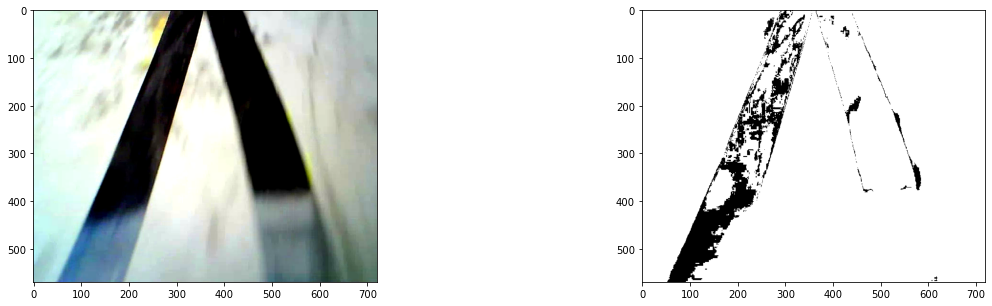

In [21]:
for i in relevantFrames:
    auto_result, alpha, beta = automatic_brightness_and_contrast(frameArray[i].copy())
    hsv = cv2.cvtColor(auto_result, cv2.COLOR_BGR2HSV)
    h,s,v = cv2.split(hsv) 
    
    components = [h,s,v]
    thresholds,indexc = otsuThresh(components)
    
    imageCopy = cv2.cvtColor(frameArray[i],cv2.COLOR_BGR2RGB).copy()
    #print(indexc)
    for linha in range(len(h)):
        for coluna in range(len(h[linha])):
            if(indexc == 0):  
                if h[linha,coluna] <=thresholds[0]:
                    imageCopy[linha,coluna] = 255
                else:
                    imageCopy[linha,coluna] = 0
            elif(indexc == 1):  
                if s[linha,coluna] <=thresholds[1]:
                    imageCopy[linha,coluna] = 255
                else:
                    imageCopy[linha,coluna] = 0
            elif(indexc == 2):  
                if v[linha,coluna] <=thresholds[2]:
                    imageCopy[linha,coluna] = 255
                else:
                    imageCopy[linha,coluna] = 0   
                    
    fig = plt.figure(figsize = (20,5))
    fig.add_subplot(1,2,1)
    plt.imshow(cv2.cvtColor(auto_result,cv2.COLOR_BGR2RGB))
    fig.add_subplot(1,2,2)
    plt.imshow(imageCopy)
    plt.show()

Segundo o heatmap e teste com o algoritmo que já tinhamos não parece que este pré-processamento resulte.

Next step testar "Robust Locally-Adaptive Soft Binarization" por FalconUA

### Teste Canny Edge Detection

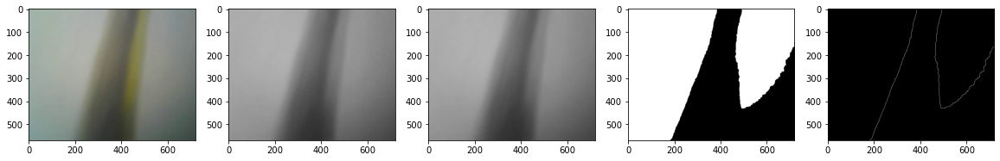

Theta mais comum: 1.5707963267948966
Nº ocorrencias: 6


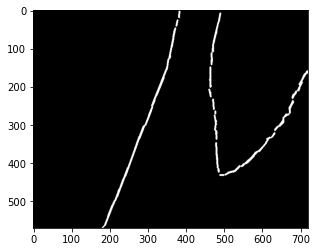

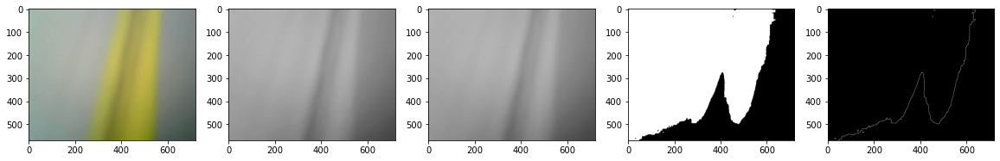

Theta mais comum: -0.7853981633974483
Nº ocorrencias: 4


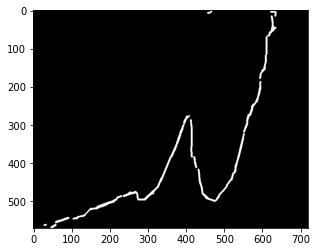

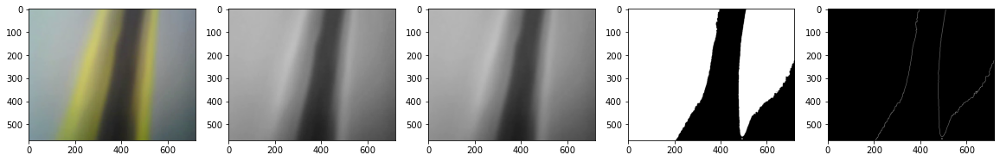

Theta mais comum: -1.5707963267948966
Nº ocorrencias: 6


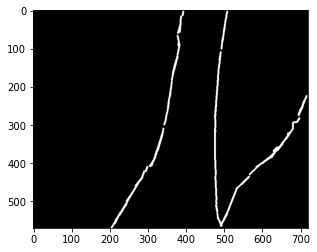

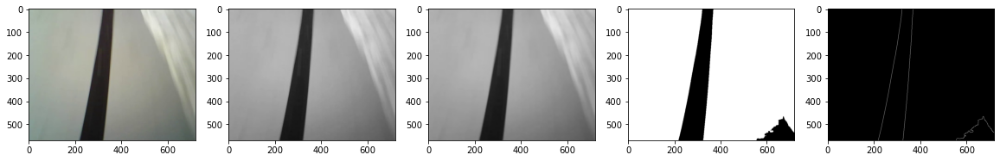

Theta mais comum: -0.7853981633974483
Nº ocorrencias: 4


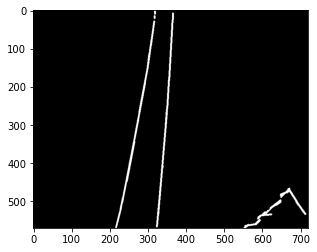

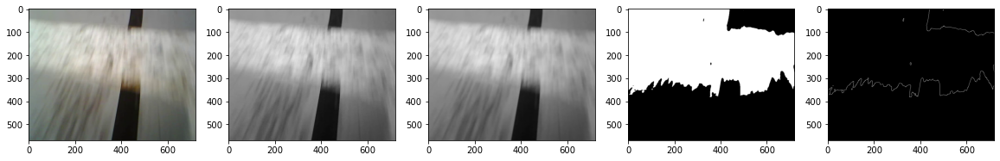

Theta mais comum: 0.0
Nº ocorrencias: 28


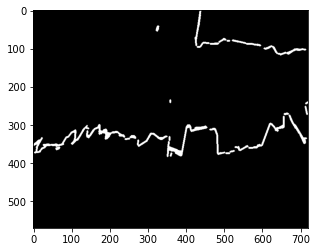

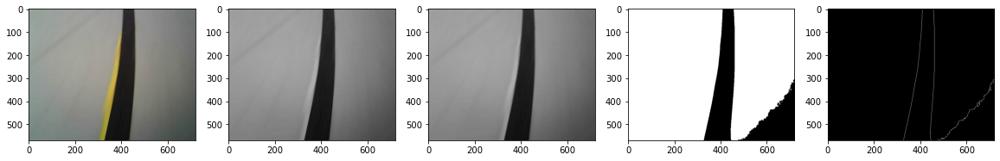

Theta mais comum: -0.7853981633974483
Nº ocorrencias: 16


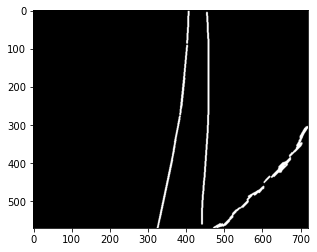

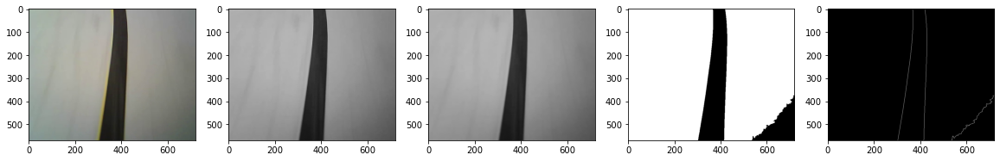

Theta mais comum: -0.7853981633974483
Nº ocorrencias: 15


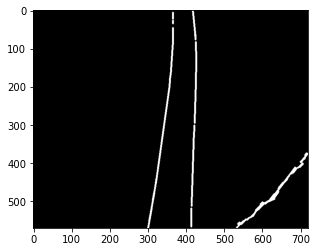

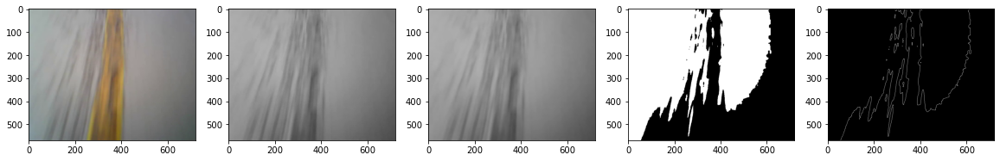

Theta mais comum: -1.5707963267948966
Nº ocorrencias: 37


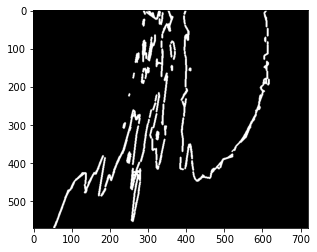

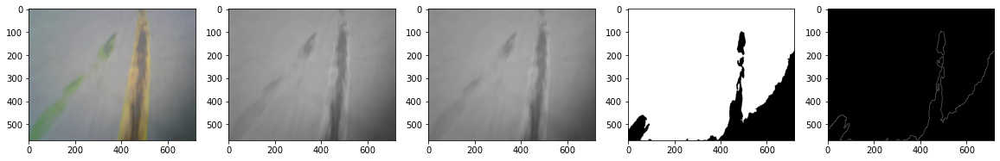

Theta mais comum: -1.5707963267948966
Nº ocorrencias: 19


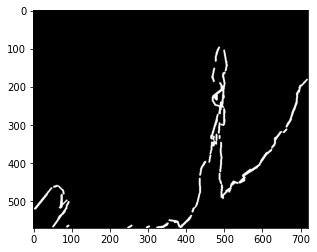

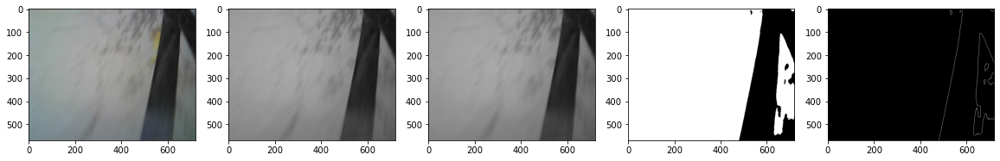

Theta mais comum: 1.5707963267948966
Nº ocorrencias: 8


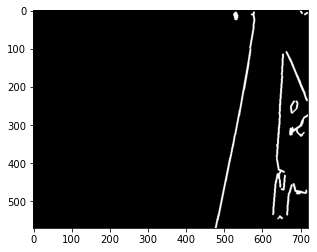

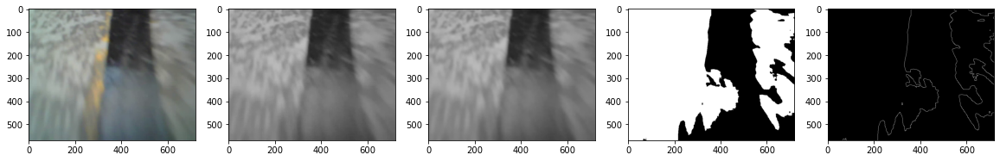

Theta mais comum: -1.5707963267948966
Nº ocorrencias: 15


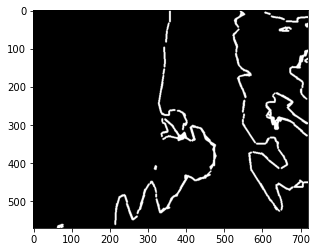

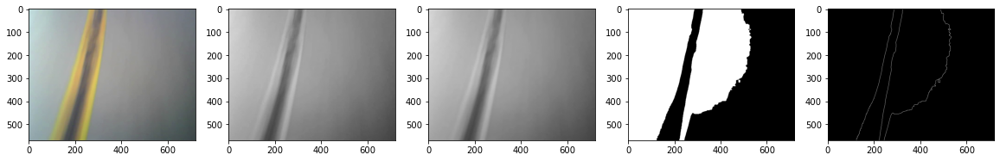

Theta mais comum: -0.7853981633974483
Nº ocorrencias: 6


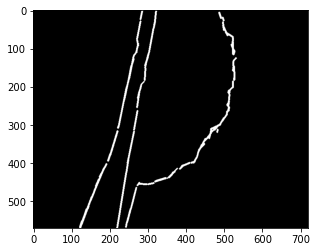

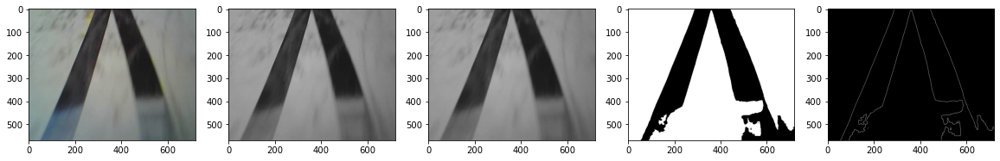

Theta mais comum: 0.0
Nº ocorrencias: 13


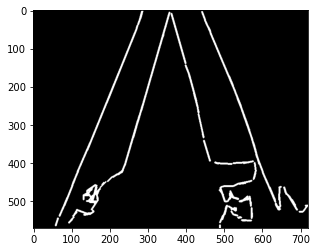

In [22]:
from collections import Counter

relevantFrames = [142,143,146,367,379,387,393,399,444,480,486,822,876]


for i in relevantFrames:
    grayFrame = cv2.cvtColor(frameArray[i].copy(),cv2.COLOR_BGR2GRAY)
    guassianFrame = cv2.blur(grayFrame.copy(),(30,30),cv2.BORDER_DEFAULT)
    guass = [guassianFrame]


    thresholds,indexc = otsuThresh(guass)
    #print(thresholds)

    blur = cv2.bilateralFilter(grayFrame.copy(),9,75,75)
    guassianFrame = cv2.GaussianBlur(grayFrame.copy(),(5,5),cv2.BORDER_DEFAULT)
    ret,thresh1 = cv2.threshold(guassianFrame,0 , 255 , cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    cannyImg = cv2.Canny(thresh1.copy(),thresholds[0]*0.5,thresholds[0])
   
    #imgplot = plt.imshow(cv2.cvtColor(thresh1,cv2.COLOR_BGR2RGB))
    #plt.show()  

    fig = plt.figure(figsize=(20,5))
    fig.add_subplot(1,5,1)
    plt.imshow(cv2.cvtColor(frameArray[i].copy(),cv2.COLOR_BGR2RGB))
    fig.add_subplot(1,5,2)
    plt.imshow(cv2.cvtColor(grayFrame,cv2.COLOR_BGR2RGB))
    fig.add_subplot(1,5,3)
    plt.imshow(cv2.cvtColor(guassianFrame,cv2.COLOR_BGR2RGB))
    fig.add_subplot(1,5,4)
    plt.imshow(cv2.cvtColor(thresh1,cv2.COLOR_BGR2RGB))
    fig.add_subplot(1,5,5)
    plt.imshow(cv2.cvtColor(cannyImg,cv2.COLOR_BGR2RGB))
    plt.show()

    """
    lines = cv2.HoughLines(cannyImg, 1, np.pi / 180, 10)
    hough = np.zeros((len(cannyImg),len(cannyImg[0])))

    if lines is not None:
        for rho,theta in lines[0]:
            a = np.cos(theta)
            b = np.sin(theta)
            x0 = a*rho
            y0 = b*rho
            x1 = int(x0 + 1000*(-b))
            y1 = int(y0 + 1000*(a))
            x2 = int(x0 - 1000*(-b))
            y2 = int(y0 - 1000*(a))
            cv2.line(hough, (x1, y1), (x2, y2), (255, 0, 0), 3)
     """                
   
    hough = np.zeros((len(cannyImg),len(cannyImg[0])))
    hough1 = np.zeros((len(cannyImg),len(cannyImg[0])))
    lines = cv2.HoughLinesP(cannyImg, 1, np.pi/180, 10, minLineLength=5, maxLineGap=10)
    
    rhoArr = []
    thetaArr = []
    rhoArr = []
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(hough, (x1, y1), (x2, y2), (255, 0, 0), 3)
        theta= math.atan2((y2-y1),(x2-x1))
        thetaArr.append(theta)
        rho = x1*np.cos(theta) + y1*np.sin(theta)
        rhoArr.append(rho)
        
    #print("Nº de thetas: " + str(len(thetaArr)))
    
    b = Counter(thetaArr)
    print("Theta mais comum: " + str(b.most_common(1)[0][0]))
    print("Nº ocorrencias: " + str(b.most_common(1)[0][1]))
    #c = Counter(rhoArr)
    #print("Rho mais comum: " + str(c.most_common(1)[0][0]))
    """
    for line in lines:
        x1, y1, x2, y2 = line[0]
        theta= math.atan2((y2-y1),(x2-x1))
        if(theta == b.most_common(1)[0][0]):
             cv2.line(hough1, (x1, y1), (x2, y2), (255, 0, 0), 3)
        

        rho = x1*np.cos(theta) + y1*np.sin(theta)
    """   
    plt.imshow(hough,cmap="gray")
    plt.show()

### Teste de conversão automática de contraste e brilho

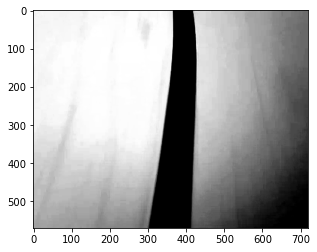

[0, 0, 0]
[30, 20, 255]


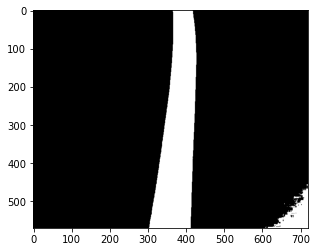

In [23]:
def convertScale(img, alpha, beta):
    """Add bias and gain to an image with saturation arithmetics. Unlike
    cv2.convertScaleAbs, it does not take an absolute value, which would lead to
    nonsensical results (e.g., a pixel at 44 with alpha = 3 and beta = -210
    becomes 78 with OpenCV, when in fact it should become 0).
    """

    new_img = img * alpha + beta
    new_img[new_img < 0] = 0
    new_img[new_img > 255] = 255
    return new_img.astype(np.uint8)

# Automatic brightness and contrast optimization with optional histogram clipping
def automatic_brightness_and_contrast(image, clip_hist_percent=25):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Calculate grayscale histogram
    hist = cv2.calcHist([gray],[0],None,[256],[0,256])
    hist_size = len(hist)

    # Calculate cumulative distribution from the histogram
    accumulator = []
    accumulator.append(float(hist[0]))
    for index in range(1, hist_size):
        accumulator.append(accumulator[index -1] + float(hist[index]))

    # Locate points to clip
    maximum = accumulator[-1]
    clip_hist_percent *= (maximum/100.0)
    clip_hist_percent /= 2.0

    # Locate left cut
    minimum_gray = 0
    while accumulator[minimum_gray] < clip_hist_percent:
        minimum_gray += 1

    # Locate right cut
    maximum_gray = hist_size -1
    while accumulator[maximum_gray] >= (maximum - clip_hist_percent):
        maximum_gray -= 1

    # Calculate alpha and beta values
    alpha = 255 / (maximum_gray - minimum_gray)
    beta = -minimum_gray * alpha

    '''
    # Calculate new histogram with desired range and show histogram 
    new_hist = cv2.calcHist([gray],[0],None,[256],[minimum_gray,maximum_gray])
    plt.plot(hist)
    plt.plot(new_hist)
    plt.xlim([0,256])
    plt.show()
    '''

    auto_result = convertScale(image, alpha=alpha, beta=beta)
    return (auto_result, alpha, beta)

#obter cor
benchmark = frameArray[393].copy()
benchmark, alpha, beta = automatic_brightness_and_contrast(benchmark)
plt.imshow(cv2.cvtColor(benchmark,cv2.COLOR_BGR2GRAY),cmap="gray")
plt.show()

hsv = cv2.cvtColor(benchmark,cv2.COLOR_BGR2HSV)

h,s,v = cv2.split(hsv)


middlePixel = [h[int(len(h)/2),int(len(h[0])/2)],
             s[int(len(s)/2),int(len(s[0])/2)],
             v[int(len(v)/2),int(len(v[0])/2)]]
floorPixel = [h[200,300],
             s[200,300],
             v[200,300]]
benchmarkEmpty = np.zeros((len(benchmark),len(benchmark[0])))
print(middlePixel)
print(floorPixel)

for i in range(len(h)):
    for j in range(len(h[i])):
        if(middlePixel[0]-10 <= h[i][j] <= middlePixel[0]+10 and
          middlePixel[1]-10 <= s[i][j] <= middlePixel[1]+10 and
          middlePixel[2]-10 <= v[i][j] <= middlePixel[2]+10):
            benchmarkEmpty[i][j] = 255
            
plt.imshow(benchmarkEmpty, cmap="gray")
plt.show()

### Teste correção automática de brilho

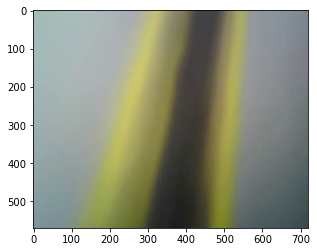

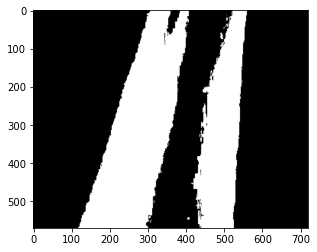

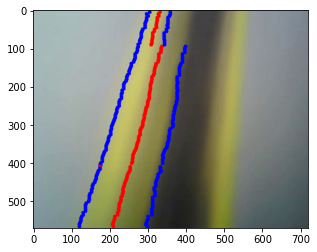

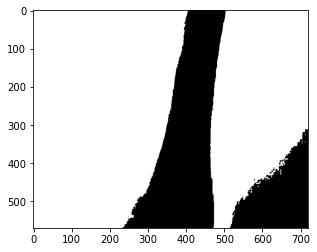

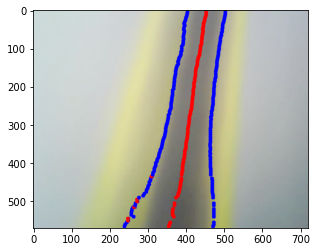

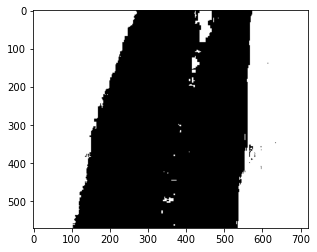

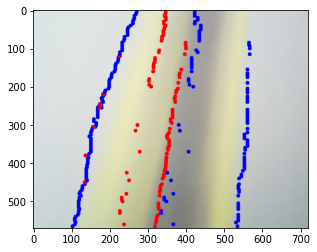

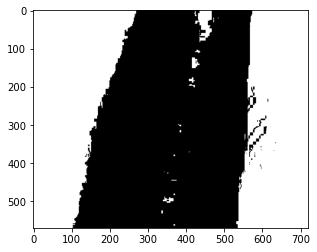

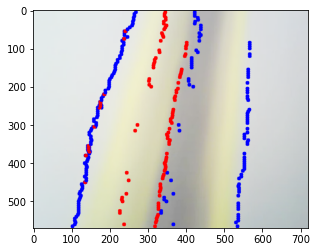

In [24]:
def adjust_gamma(image, gamma=1.0):
	# build a lookup table mapping the pixel values [0, 255] to
	# their adjusted gamma values
	invGamma = 1.0 / gamma
	table = np.array([((i / 255.0) ** invGamma) * 255
		for i in np.arange(0, 256)]).astype("uint8")
	# apply gamma correction using the lookup table
	return cv2.LUT(image, table)
            

benchmark = frameArray[relevantFrames[2]].copy() 
plt.imshow(cv2.cvtColor(benchmark,cv2.COLOR_BGR2RGB))
plt.show()

for i in range(1,5,1):
    teste = adjust_gamma(benchmark,gamma=i)
    h = len(teste)
    start_height = h - 5
    
    grayFrame = cv2.cvtColor(teste.copy(),cv2.COLOR_BGR2GRAY)
    guassianFrame = cv2.GaussianBlur(grayFrame.copy(),(5,5),cv2.BORDER_DEFAULT)
    ret,thresh1 = cv2.threshold(guassianFrame,0 , 255 , cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    
    benchmarkCopy = teste.copy()
    no_points_count = 0

    hsv = cv2.cvtColor(teste,cv2.COLOR_BGR2HSV)

    hue,saturation,value = cv2.split(hsv)
    components = [hue,saturation,value]
    thresholds,index = otsuThresh(components)
    
    ret,thresh1 =  cv2.threshold(components[index],0 , 255 , cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    plt.imshow(cv2.cvtColor(thresh1,cv2.COLOR_BGR2RGB))
    plt.show()
    
    while(start_height > 0): 
        signed_thresh = thresh1[start_height].astype(np.int16) # select only one row
        diff = np.diff(signed_thresh)   #The derivative of the start_height line

        points = np.where(np.logical_or(diff > 200, diff < -200))

        if len(points) > 0 and len(points[0]) > 1:
            middle = int((points[0][0] + points[0][1]) / 2)

            cv2.circle(benchmarkCopy, (points[0][0], start_height), 5, (255,0,0), -1)
            cv2.circle(benchmarkCopy, (points[0][1], start_height), 5, (255,0,0), -1)
            cv2.circle(benchmarkCopy, (middle, start_height), 5, (0,0,255), -1)
            start_height -= 5
            start_height = start_height % h
        else:
            start_height -= 5
            start_height = start_height % h        
            no_points_count += 1    
    plt.imshow(cv2.cvtColor(benchmarkCopy,cv2.COLOR_BGR2RGB))
    plt.show()

   